# Práctica Final - Modulo El Trabajo de la Ciencia de Datos


## 1. Enunciado

Valencian Telecomunications, SA (VALTEL) es una compañía prestadora de servicios de telecomunicaciones que se ha especializado en ciudadanos no nacionales residentes en España. Su propuesta de valor es ofrecer packs económicos focalizados en las llamadas internacionales y la itinerancia de datos (roaming) y tarifas flexibles de datos.

En su plan estratégico, se contempla la diversificación de servicios y se plantea el diseño de nuevas áreas de la compañía dedicadas a comercializar a través de internet bienes de interés para el colectivo de ciudadanos no nacionales. Por medio de encuestas a sus clientes, se ha detectado que la compra de vehículos para ciudadanos no nacionales puede ser un potencial nicho, y, concretamente, el mercado de coches de segunda mano.

VALTEL desea ofertar dentro de su app móvil un servicio que permita a sus clientes buscar vehículos en venta y ofrecerles un precio competitivo. Para conocer dicho precio, el área de I+D ha conseguido un dataset (Coches_Segunda_Mano.csv) con las ventas de vehículos de segunda mano y encarga al área de Ciencia de Datos la estimación del precio de cada vehículo para poder elaborar una tarifa competitiva.

Por tanto, el trabajo para realizar será el siguiente:

1. Utilizar la metodología CRISP-DM para estimar el precio de un vehículo (campo Precio). Se recomienda utilizar como base el cuaderno del caso de repaso o bien BigML.

2. Realizar una narrativa que comunique los hallazgos. Por simplicidad, se recomienda utilizar PowerPoint o equivalente para realizar la narrativa.

### 1.1 Configuración del entorno

Ejecutar la siguiente celda para configurar el entorno.

In [73]:
import pandas as pd                # Librería de manejo de datos tabulares
import numpy as np                 # Librería de manejo de vectores y matrices
pd.options.display.max_columns = 50 # Para visualizar mas columnas
from math import ceil

import seaborn as sns              # Librería de visualización
import matplotlib.pyplot as plt
from matplotlib.ticker import FuncFormatter

from google.colab import files
from google.colab import data_table

from sklearn.preprocessing import MinMaxScaler, StandardScaler, LabelEncoder
from pathlib import Path
from sklearn import linear_model
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
from sklearn.model_selection import train_test_split

pd.options.display.float_format = "{:.2f}".format
sns.set(color_codes=True)
sns.set_theme(style="white")

# Ignorar las advertencias
import warnings
warnings.filterwarnings('ignore')

### 1.2 Metodología

Siguiendo lo expuesto en el contenido del módulo, vamos a utilizar la metodología CRISP-DM para abordar este proyecto. Recordar que consta de las siguientes fases:

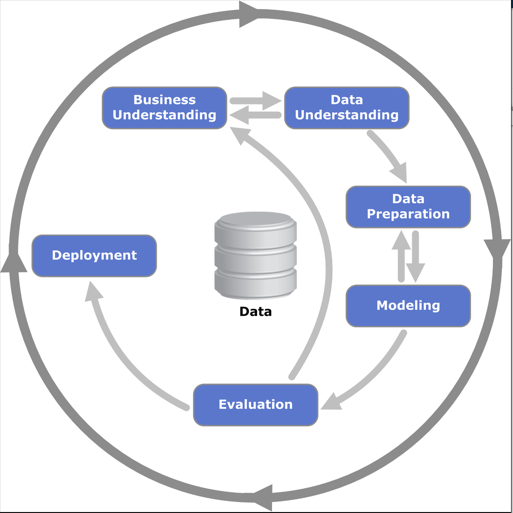



## 2. Entendimiento del negocio

Como se expone en el enunciado, lo que se pretende es estimar el **precio** de un vehículo. Concretamente, lo que vamos a ilustrar es como estimar la variable **Precio** del dataset "Coches_Segunda_Mano.csv".

## 3. Entendimiento de los datos

Para comenzar el entendimiento de los datos, debemos subir el fichero "Coches_Segunda_Mano.csv" (al darle al botón de ejecutar, aparecerá en la parte inferior de la celda un botón "Elegir archivos")

In [74]:
uploaded = files.upload()

for fn in uploaded.keys():
  print('Se ha subido el fichero "{name}" con longitud {length} bytes'.format(
      name=fn, length=len(uploaded[fn])))

Saving Coches_Segunda_Mano.csv to Coches_Segunda_Mano (1).csv
Se ha subido el fichero "Coches_Segunda_Mano (1).csv" con longitud 1606997 bytes


### 3.1 Descripción general de los datos

In [75]:
print(f"Tamaño del fichero: {Path('Coches_Segunda_Mano.csv').stat().st_size} bytes")
print()
print("Número total de líneas:")
!wc -l Coches_Segunda_Mano.csv
print()
print("Primeras 10 líneas:")
!head -n 10 Coches_Segunda_Mano.csv
print("...")
print("Últimas 10 líneas")
!tail -n 10 Coches_Segunda_Mano.csv

Tamaño del fichero: 1606997 bytes

Número total de líneas:
11915 Coches_Segunda_Mano.csv

Primeras 10 líneas:
Marca,Modelo,Año,Combustible,CV,Cilindros,Transmisión,Tracción,Puertas,Mercado,Tamaño,Estilo,Consumo Carretera,Consumo Ciudad,Popularidad,Precio
BMW,1 Series M,2011,premium unleaded (required),335.0,6.0,MANUAL,rear wheel drive,2.0,"Factory Tuner,Luxury,High-Performance",Compact,Coupe,26.0,19.0,3916,46135.0
BMW,1 Series,2011,premium unleaded (required),300.0,6.0,MANUAL,rear wheel drive,2.0,"Luxury,Performance",Compact,Convertible,28.0,19.0,3916,40650.0
BMW,1 Series,2011,premium unleaded (required),300.0,6.0,MANUAL,rear wheel drive,2.0,"Luxury,High-Performance",Compact,Coupe,28.0,20.0,3916,36350.0
BMW,1 Series,2011,premium unleaded (required),230.0,6.0,MANUAL,rear wheel drive,2.0,"Luxury,Performance",Compact,Coupe,28.0,18.0,3916,29450.0
BMW,1 Series,2011,premium unleaded (required),230.0,6.0,MANUAL,rear wheel drive,2.0,Luxury,Compact,Convertible,28.0,18.0,3916,34500.0
BMW,1 Serie

In [76]:
# Carga del fichero a dataframe
df = pd.read_csv("Coches_Segunda_Mano.csv")
data_table.DataTable.max_columns = 30 # Por defecto, el límite de columnas es 20
data_table.DataTable(df, include_index=False, num_rows_per_page=10)

,Marca,Modelo,Año,Combustible,CV,Cilindros,Transmisión,Tracción,Puertas,Mercado,Tamaño,Estilo,Consumo Carretera,Consumo Ciudad,Popularidad,Precio
0,BMW,1 Series M,2011,premium unleaded (required),335.00,6.00,MANUAL,rear wheel drive,2.00,"Factory Tuner,Luxury,High-Performance",Compact,Coupe,26.00,19.00,3916,46135.00
1,BMW,1 Series,2011,premium unleaded (required),300.00,6.00,MANUAL,rear wheel drive,2.00,"Luxury,Performance",Compact,Convertible,28.00,19.00,3916,40650.00
2,BMW,1 Series,2011,premium unleaded (required),300.00,6.00,MANUAL,rear wheel drive,2.00,"Luxury,High-Performance",Compact,Coupe,28.00,20.00,3916,36350.00
3,BMW,1 Series,2011,premium unleaded (required),230.00,6.00,MANUAL,rear wheel drive,2.00,"Luxury,Performance",Compact,Coupe,28.00,18.00,3916,29450.00
4,BMW,1 Series,2011,premium unleaded (required),230.00,6.00,MANUAL,rear wheel drive,2.00,Luxury,Compact,Convertible,28.00,18.00,3916,34500.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11909,Acura,ZDX,2012,premium unleaded (required),300.00,6.00,AUTOMATIC,all wheel drive,4.00,"Crossover,Hatchback,Luxury",Midsize,4dr Hatchback,23.00,16.00,204,46120.00
11910,Acura,ZDX,2012,premium unleaded (required),300.00,6.00,AUTOMATIC,all wheel drive,4.00,"Crossover,Hatchback,Luxury",Midsize,4dr Hatchback,23.00,16.00,204,56670.00
11911,Acura,ZDX,2012,premium unleaded (required),300.00,6.00,AUTOMATIC,all wheel drive,4.00,"Crossover,Hatchback,Luxury",Midsize,4dr Hatchback,23.00,16.00,204,50620.00
11912,Acura,ZDX,2013,premium unleaded (recommended),300.00,6.00,AUTOMATIC,all wheel drive,4.00,"Crossover,Hatchback,Luxury",Midsize,4dr Hatchback,23.00,16.00,204,50920.00


Veamos información sobre el dataframe cargado:

In [77]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11914 entries, 0 to 11913
Data columns (total 16 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Marca              11914 non-null  object 
 1   Modelo             11914 non-null  object 
 2   Año                11914 non-null  int64  
 3   Combustible        11911 non-null  object 
 4   CV                 11845 non-null  float64
 5   Cilindros          11884 non-null  float64
 6   Transmisión        11914 non-null  object 
 7   Tracción           11914 non-null  object 
 8   Puertas            11908 non-null  float64
 9   Mercado            8172 non-null   object 
 10  Tamaño             11914 non-null  object 
 11  Estilo             11914 non-null  object 
 12  Consumo Carretera  11914 non-null  float64
 13  Consumo Ciudad     11914 non-null  float64
 14  Popularidad        11914 non-null  int64  
 15  Precio             11914 non-null  float64
dtypes: float64(6), int64(2

Veamos el tipo de datos de cada variable:

In [78]:
print (df.dtypes)

Marca                 object
Modelo                object
Año                    int64
Combustible           object
CV                   float64
Cilindros            float64
Transmisión           object
Tracción              object
Puertas              float64
Mercado               object
Tamaño                object
Estilo                object
Consumo Carretera    float64
Consumo Ciudad       float64
Popularidad            int64
Precio               float64
dtype: object


Donde *object* representa a un variable categórica (cadena), *int64* es un número entero y *float64* un número real.

De este primer vistazo, se puede observar que:
*  A la variable **Precio** la interpreta correctamente como una variable numérica continua (float64)

* A las variables **CV**, **Cilindros**, **Puertas** las interpreta como variables numéricas tipo float64, es decir continuas. Vamos a cambiarlas a tipo numericas discretas.

In [79]:
# Convertir la columna a numérica, manejando posibles errores
columns = ['CV','Cilindros','Puertas']
for col in columns:
  df[col] = pd.to_numeric(df[col], errors='coerce')
  df[col].fillna(0, inplace=True)
  df[col] = df[col].astype(int)

In [80]:
print (df.dtypes)

Marca                 object
Modelo                object
Año                    int64
Combustible           object
CV                     int64
Cilindros              int64
Transmisión           object
Tracción              object
Puertas                int64
Mercado               object
Tamaño                object
Estilo                object
Consumo Carretera    float64
Consumo Ciudad       float64
Popularidad            int64
Precio               float64
dtype: object


### 3.2 Análisis Univariante

Para comenzar el análisis univariante, vamos a crear dos dataframe separados con las variables cualitativas y las cuantitativas, donde nos preparamos los estadísticos básicos de cada una. Esto nos facilitará el estudio por separado.

In [81]:
def analyze_df(df):
  data_types = dict(df.dtypes)
  numeric_cols = []
  categoric_cols = []
  for c,t in data_types.items():
    if t == np.float64:
      numeric_cols.append([c, 'Cuantitativa continua', df[c].mean(), df[c].min(), df[c].max(), df[c].median()])
    elif t == np.int64 or pd.Int64Dtype.is_dtype(t):
      numeric_cols.append([c, 'Cuantitativa discreta', df[c].mean(), df[c].min(), df[c].max(), df[c].median()])
    else:
      categoric_cols.append([c, f'Cualitativa', df[c].nunique()])
  n = pd.DataFrame(numeric_cols, columns=['Nombre', 'Tipo de variable', 'Media', 'Mínimo', 'Máximo', 'Mediana'])
  c = pd.DataFrame(categoric_cols, columns=['Nombre', 'Tipo de variable', 'Número de clases'])
  return n, c

numeric_types, categoric_types = analyze_df(df)
print("Finalizado OK")


Finalizado OK


#### 3.2.1 Variables Cualitativas

Ejecutando la siguiente celda, permite observar las columnas con datos cualitativos junto con el número de clases de cada una de ellas.

In [82]:
print(categoric_types.to_string(index=False))

     Nombre Tipo de variable  Número de clases
      Marca      Cualitativa                48
     Modelo      Cualitativa               915
Combustible      Cualitativa                10
Transmisión      Cualitativa                 5
   Tracción      Cualitativa                 4
    Mercado      Cualitativa                71
     Tamaño      Cualitativa                 3
     Estilo      Cualitativa                16


In [83]:
# Observación más detallada de los valores de las columnas
for col in df.columns:
    print(f"{col}: {df[col].unique()}\n")

Marca: ['BMW' 'Audi' 'FIAT' 'Mercedes-Benz' 'Chrysler' 'Nissan' 'Volvo' 'Mazda'
 'Mitsubishi' 'Ferrari' 'Alfa Romeo' 'Toyota' 'McLaren' 'Maybach'
 'Pontiac' 'Porsche' 'Saab' 'GMC' 'Hyundai' 'Plymouth' 'Honda'
 'Oldsmobile' 'Suzuki' 'Ford' 'Cadillac' 'Kia' 'Bentley' 'Chevrolet'
 'Dodge' 'Lamborghini' 'Lincoln' 'Subaru' 'Volkswagen' 'Spyker' 'Buick'
 'Acura' 'Rolls-Royce' 'Maserati' 'Lexus' 'Aston Martin' 'Land Rover'
 'Lotus' 'Infiniti' 'Scion' 'Genesis' 'HUMMER' 'Tesla' 'Bugatti']

Modelo: ['1 Series M' '1 Series' '100' '124 Spider' '190-Class' '2 Series' '200'
 '200SX' '240SX' '240' '2' '3 Series Gran Turismo' '3 Series' '300-Class'
 '3000GT' '300' '300M' '300ZX' '323' '350-Class' '350Z' '360' '370Z' '3'
 '4 Series Gran Coupe' '4 Series' '400-Class' '420-Class' '456M'
 '458 Italia' '4C' '4Runner' '5 Series Gran Turismo' '5 Series'
 '500-Class' '500e' '500' '500L' '500X' '550' '560-Class' '570S' '575M'
 '57' '599' '5' '6 Series Gran Coupe' '6 Series' '600-Class' '6000'
 '612 Scaglietti

Se puede observar que:
* La variable "Modelo" cuenta con una gran cantidad de valores posibles.
* Se podría reducir la variable "Combustible" en menos categorias, por ejemplo:
  * premium unleaded, regular unleaded, flex-fuel, diesel, electric, natural gas.
* Para la variable "Tracción" se reducirián a tres categorias, juntando en una sola "four wheel drive" y "all wheel drive"



Visualizamos las variables cualitativas para conocer su distribución de valores

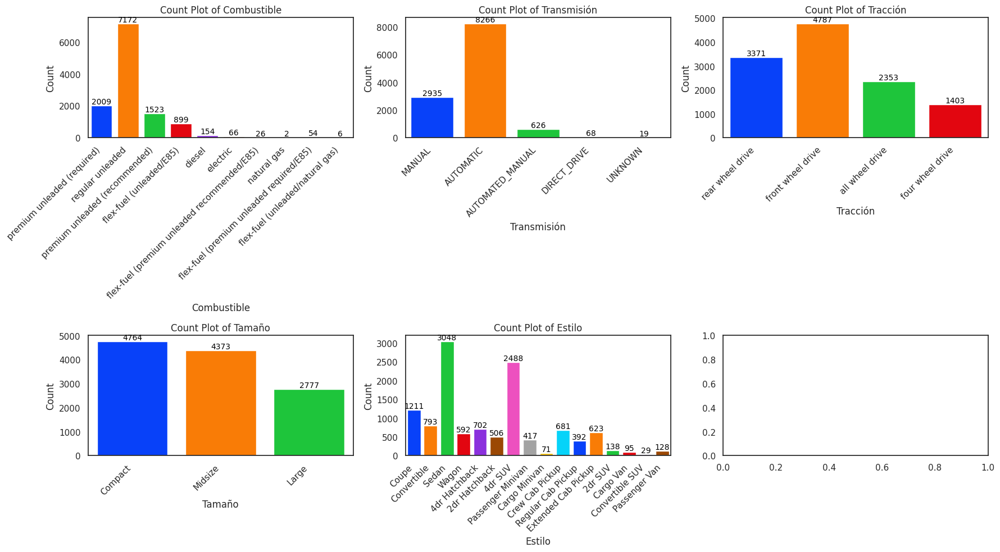

In [84]:
# Lista de columnas categóricas
categorical_columns = ['Combustible', 'Transmisión', 'Tracción', 'Tamaño',
                       'Estilo']

# Creación de subplots
fig, axes = plt.subplots(nrows=2, ncols=3, figsize=(18, 10))
axes = axes.ravel()  # Aplanamos a 2d array

# Recorremos columnas categóricas
for i, column in enumerate(categorical_columns):
    chart = sns.countplot(x=df[column], data=df, palette='bright', ax=axes[i], saturation=0.95)
    for container in axes[i].containers:
        axes[i].bar_label(container, color='black', size=10)
    axes[i].set_title(f'Count Plot of {column.capitalize()}')
    axes[i].set_xlabel(column.capitalize())
    axes[i].set_ylabel('Count')
    chart.set_xticklabels(chart.get_xticklabels(), rotation=45, horizontalalignment='right');

# Ajuste y muestra de plots
plt.tight_layout()
plt.show()

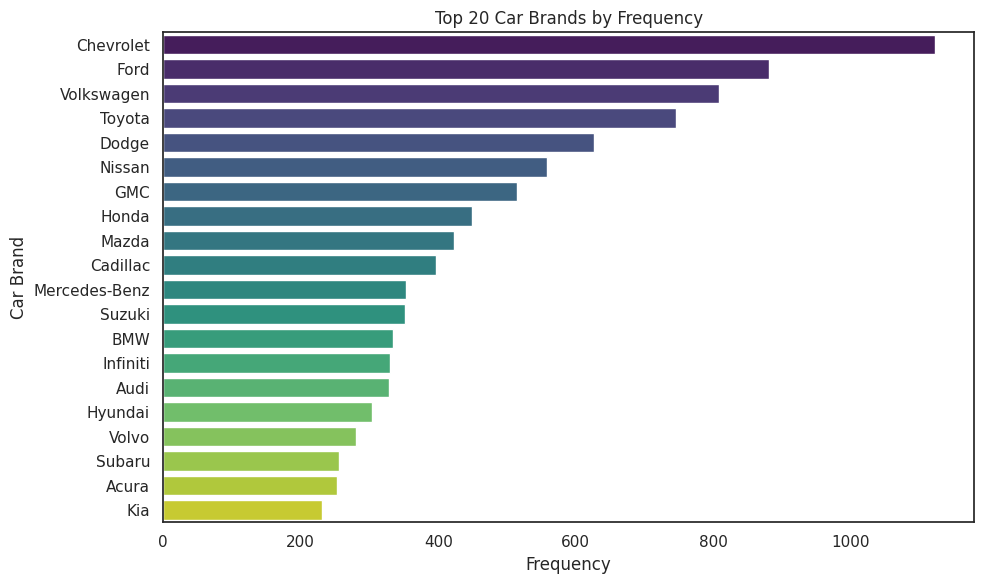

In [85]:
# TOP 20 Marcas de coches

# Definir el número de mercados a mostrar
n = 20

# Obtener los 20 mercados principales por frecuencia
top_car_brands = df['Marca'].value_counts().head(n)

# Crear la figura y los ejes para la gráfica
plt.figure(figsize=(10, 6))

# Crear la gráfica de barras
sns.barplot(x=top_car_brands.values, y=top_car_brands.index, palette='viridis')

# Configurar el título y las etiquetas de los ejes
plt.title(f'Top {n} Car Brands by Frequency')
plt.xlabel('Frequency')
plt.ylabel('Car Brand')

# Ajustar el diseño de la gráfic
plt.tight_layout()

# Mostrar la gráfica
plt.show()


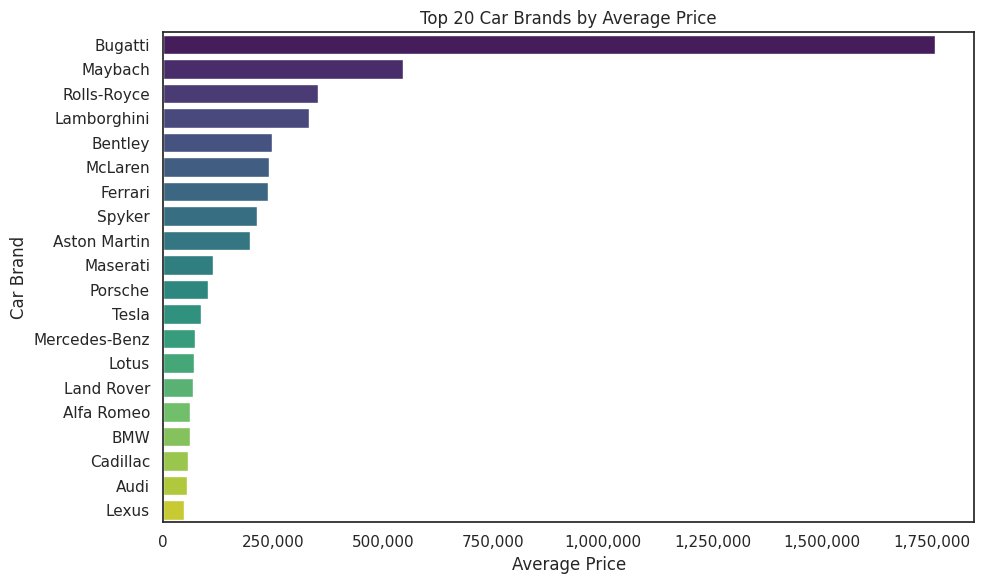

In [86]:
# Precio promedio por Marca de coche
avg_prices_by_brand = df.groupby('Marca')['Precio'].mean().sort_values(ascending=False)

# Gráfica de top 20 Marca de coche por precio promedio
n = 20
top_car_brands = avg_prices_by_brand.head(n)

plt.figure(figsize=(10, 6))
sns.barplot(x=top_car_brands.values, y=top_car_brands.index, palette='viridis')
plt.title(f'Top {n} Car Brands by Average Price')
plt.xlabel('Average Price')
plt.ylabel('Car Brand')

# Formatear el eje X para mostrar todos los ceros
formatter = FuncFormatter(lambda x, _: f'{int(x):,}')
plt.gca().xaxis.set_major_formatter(formatter)

plt.tight_layout()
plt.show()

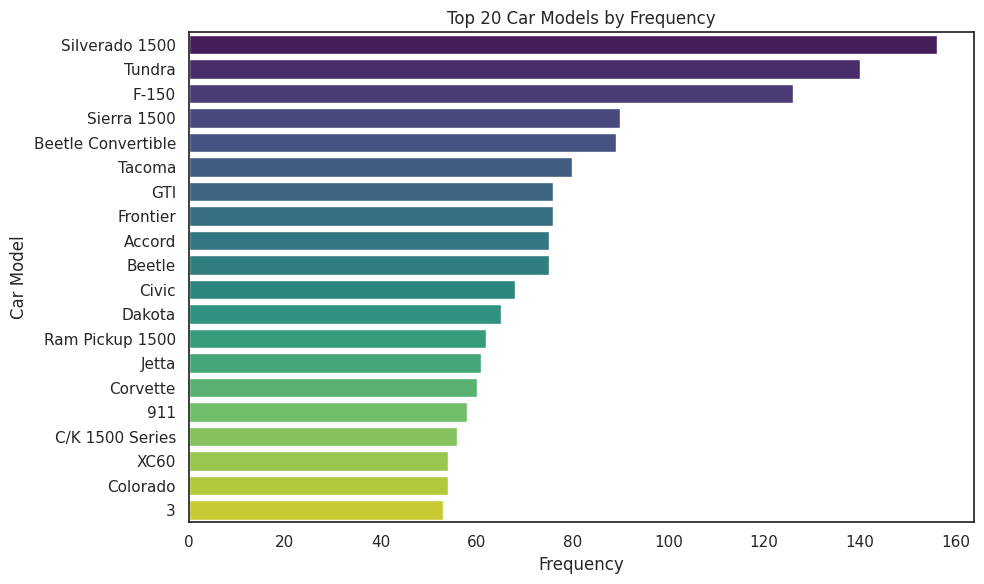

In [87]:
# TOP 20 Modelos de coches
# Definir el número de mercados a mostrar
n = 20

# Obtener los 20 mercados principales por frecuencia
top_car_model = df['Modelo'].value_counts().head(n)

# Crear la figura y los ejes para la gráfica
plt.figure(figsize=(10, 6))

# Crear la gráfica de barras
sns.barplot(x=top_car_model.values, y=top_car_model.index, palette='viridis')

# Configurar el título y las etiquetas de los ejes
plt.title(f'Top {n} Car Models by Frequency')
plt.xlabel('Frequency')
plt.ylabel('Car Model')

# Ajustar el diseño de la gráfica
plt.tight_layout()

# Mostrar la gráfica
plt.show()

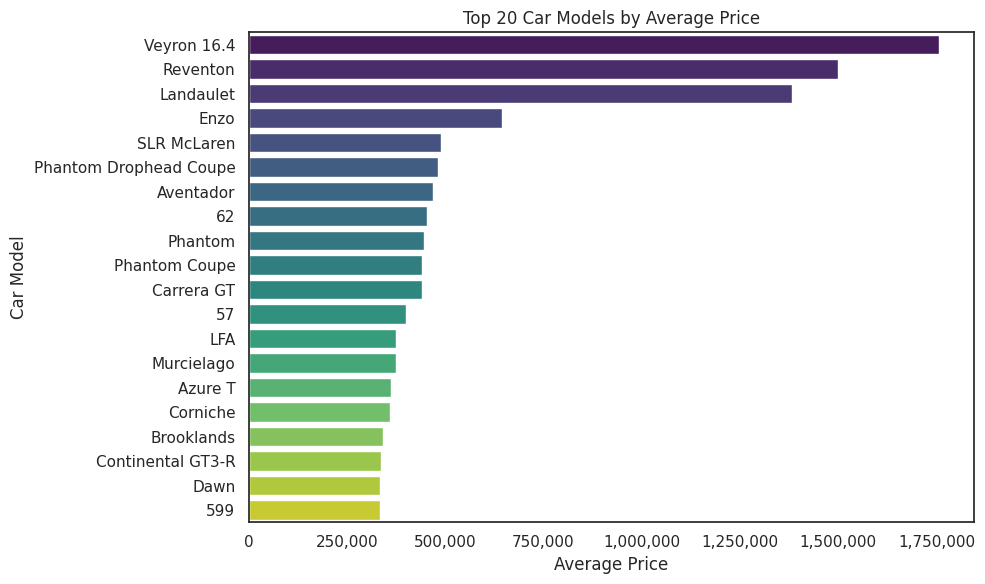

In [88]:
# Precio promedio por Model de coche
avg_prices_by_model = df.groupby('Modelo')['Precio'].mean().sort_values(ascending=False)

# Gráfica de top 20 modelos de coche por precio promedio
n = 20
top_car_models = avg_prices_by_model.head(n)

plt.figure(figsize=(10, 6))
sns.barplot(x=top_car_models.values, y=top_car_models.index, palette='viridis')
plt.title(f'Top {n} Car Models by Average Price')
plt.xlabel('Average Price')
plt.ylabel('Car Model')

# Formatear el eje X para mostrar todos los ceros
formatter = FuncFormatter(lambda x, _: f'{int(x):,}')
plt.gca().xaxis.set_major_formatter(formatter)

plt.tight_layout()
plt.show()

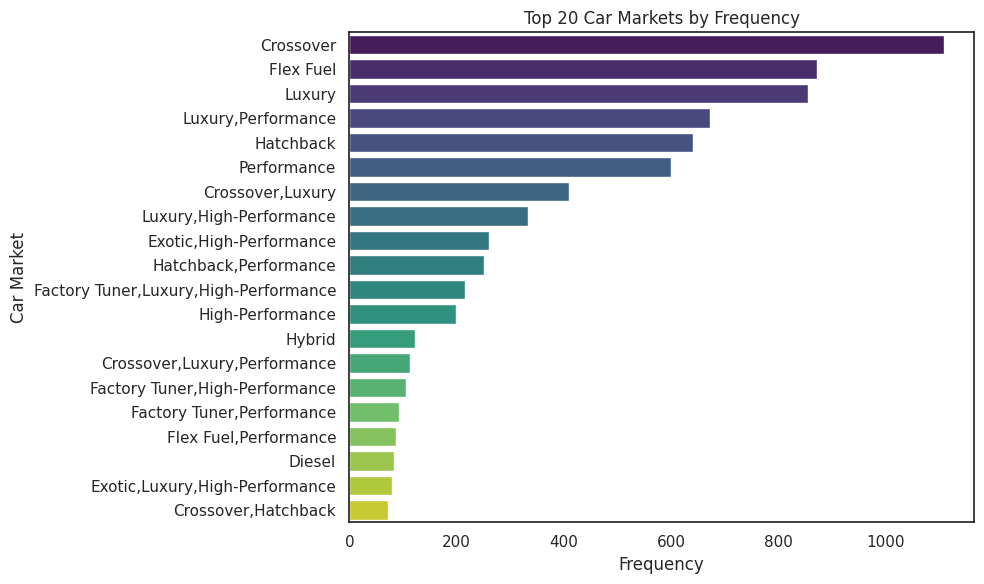

In [89]:
# TOP 20 Mercados de coches
# Definir el número de mercados a mostrar
n = 20

# Obtener los 20 mercados principales por frecuencia
top_car_market = df['Mercado'].value_counts().head(n)

# Crear la figura y los ejes para la gráfica
plt.figure(figsize=(10, 6))

# Crear la gráfica de barras
sns.barplot(x=top_car_market.values, y=top_car_market.index, palette='viridis')

# Configurar el título y las etiquetas de los ejes
plt.title(f'Top {n} Car Markets by Frequency')
plt.xlabel('Frequency')
plt.ylabel('Car Market')

# Ajustar el diseño de la gráfica
plt.tight_layout()

# Mostrar la gráfica
plt.show()

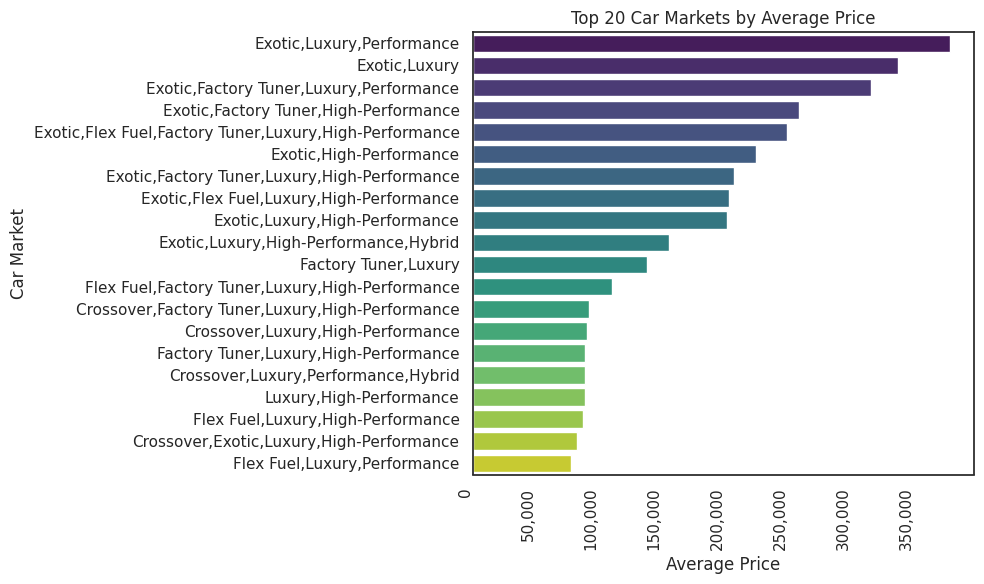

In [90]:
# Precio promedio por Mercado de coche
avg_prices_by_market = df.groupby('Mercado')['Precio'].mean().sort_values(ascending=False)

# Gráfica de top 20 modelos de coche por precio promedio
n = 20
top_car_market = avg_prices_by_market.head(n)

plt.figure(figsize=(10, 6))
chart = sns.barplot(x=top_car_market.values, y=top_car_market.index, palette='viridis')
plt.title(f'Top {n} Car Markets by Average Price')
plt.xlabel('Average Price')
plt.ylabel('Car Market')
chart.set_xticklabels(chart.get_xticklabels(), rotation=90, horizontalalignment='right');

# Formatear el eje X para mostrar todos los ceros
formatter = FuncFormatter(lambda x, _: f'{int(x):,}')
plt.gca().xaxis.set_major_formatter(formatter)

plt.tight_layout()
plt.show()

#### 3.2.2 Variables Cuantitativas


Procedamos de manera análoga con las variables cuantitativas y vemos sus estadísticos básicos:

In [91]:
print(numeric_types.to_string(index=False))

           Nombre      Tipo de variable    Media  Mínimo     Máximo  Mediana
              Año Cuantitativa discreta  2010.38 1990.00    2017.00  2015.00
               CV Cuantitativa discreta   247.94    0.00    1001.00   225.00
        Cilindros Cuantitativa discreta     5.61    0.00      16.00     6.00
          Puertas Cuantitativa discreta     3.43    0.00       4.00     4.00
Consumo Carretera Cuantitativa continua    26.64   12.00     354.00    26.00
   Consumo Ciudad Cuantitativa continua    19.73    7.00     137.00    18.00
      Popularidad Cuantitativa discreta  1554.91    2.00    5657.00  1385.00
           Precio Cuantitativa continua 40594.74 2000.00 2065902.00 29995.00


Para conocer su distribución las visualizamos cada una con un histograma:

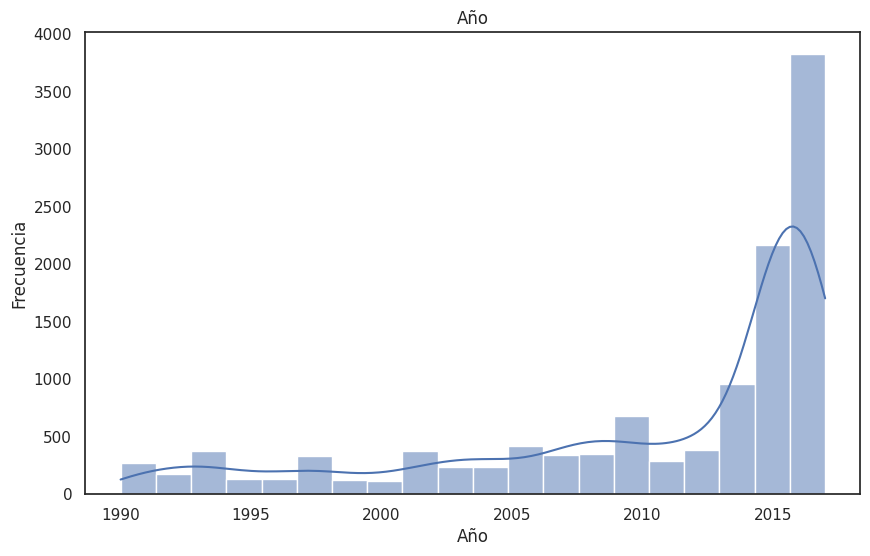

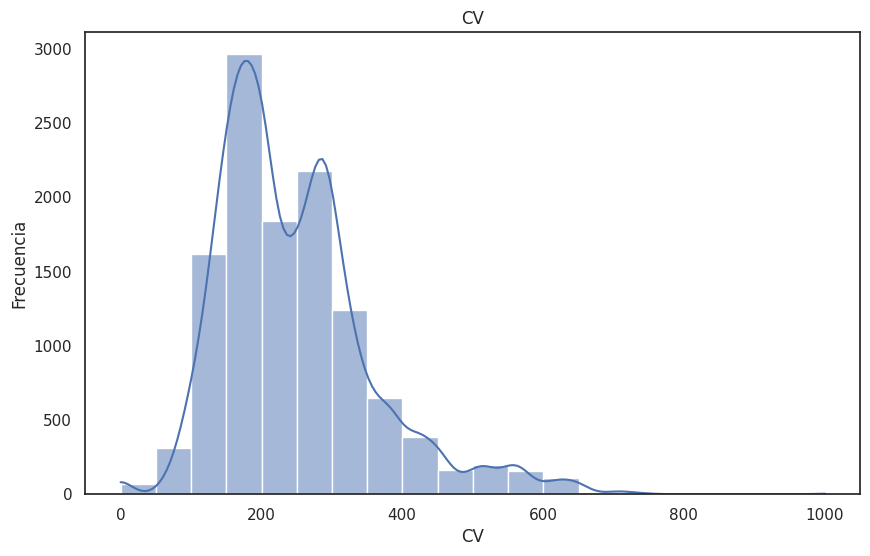

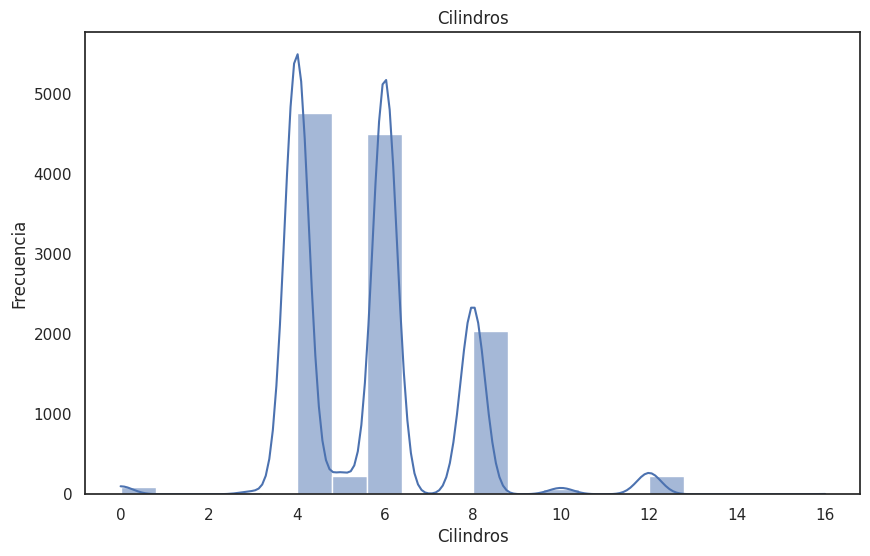

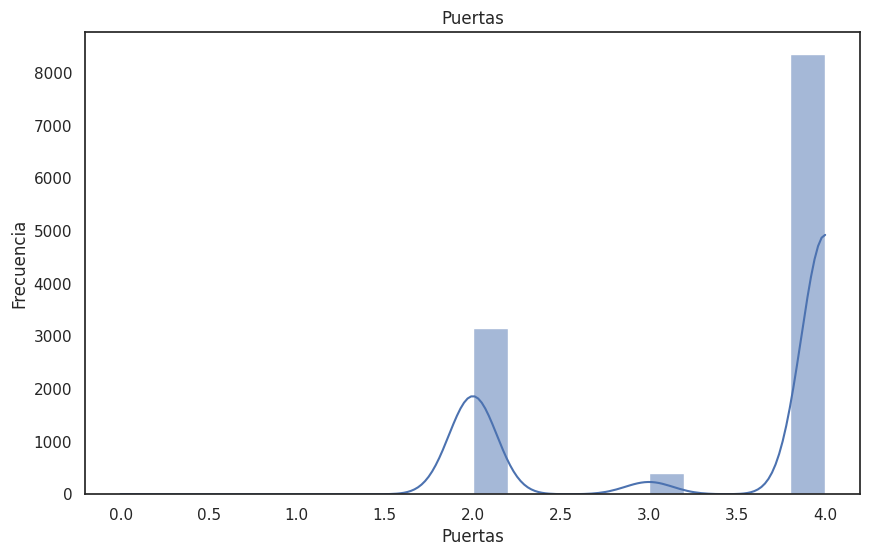

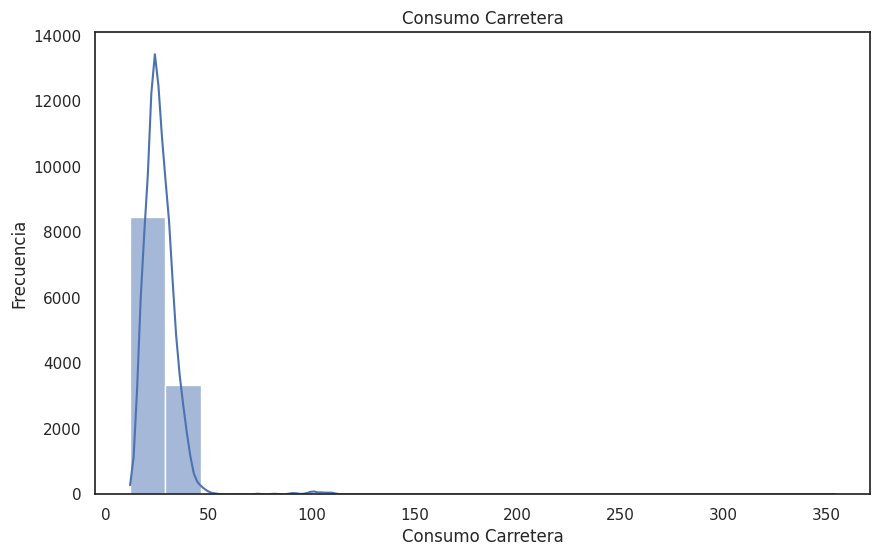

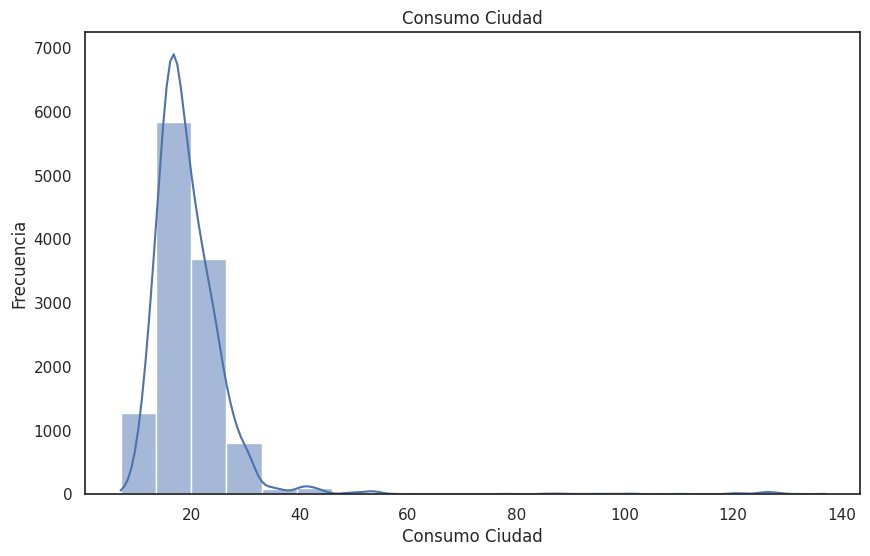

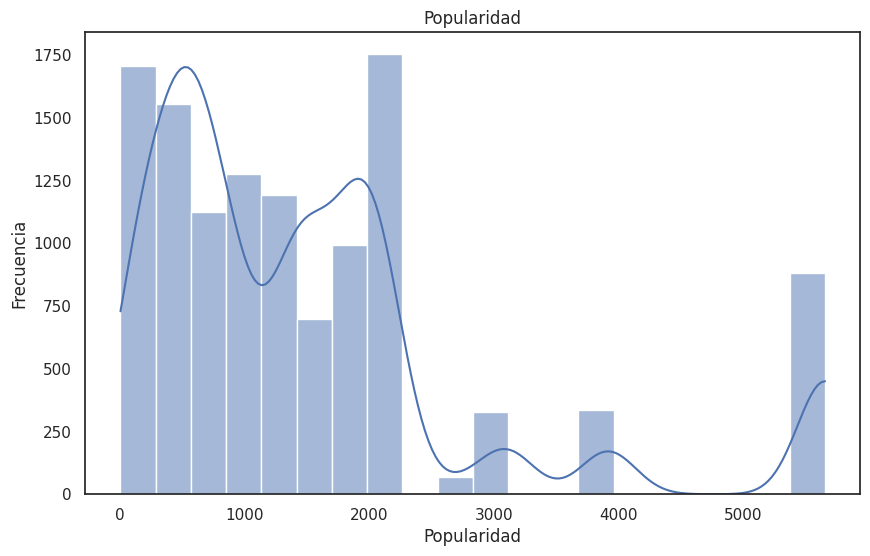

In [92]:
for i in numeric_types.index:
    column = numeric_types['Nombre'][i]
    if column == 'Precio':
        continue
    plt.figure(figsize=(10, 6))
    sns.histplot(df[column], bins=20, kde=True)
    plt.xlabel(column)
    plt.ylabel('Frecuencia')
    plt.title(column)
    plt.show()

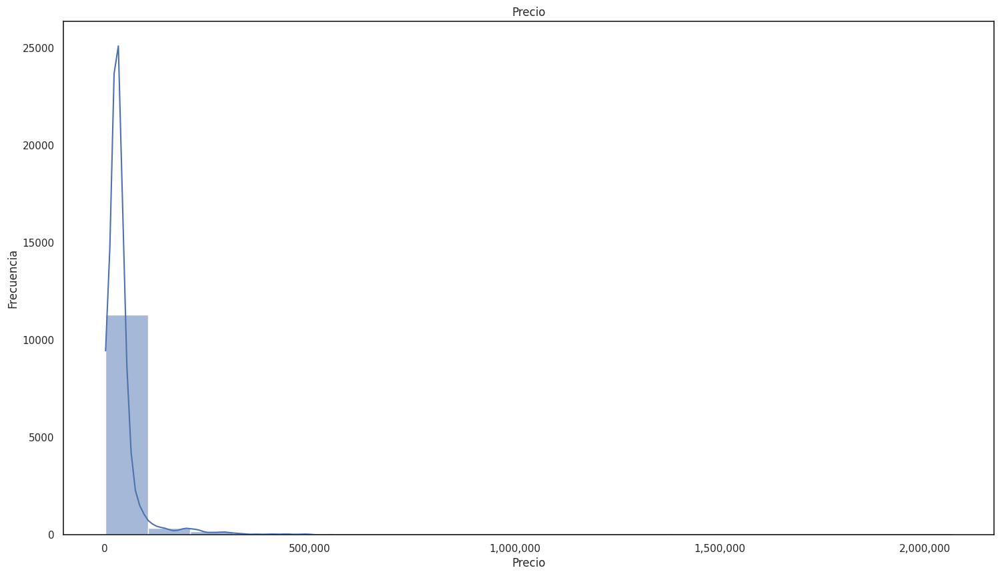

In [93]:
# Análisis variable Precio
plt.figure(figsize=(18, 10))
sns.histplot(data=df['Precio'], bins=20, kde=True)
plt.title('Precio')
plt.ylabel('Frecuencia')

# Formatear el eje X para mostrar todos los ceros
formatter = FuncFormatter(lambda x, _: f'{int(x):,}')
plt.gca().xaxis.set_major_formatter(formatter)

plt.show()

### 3.3. Análisis Bivariante

Vamos a realizar el análisis de cada variable frente a la variable objetivo que en este caso es el Precio.

#### 3.3.1 Variables Cualitativas vs Variable Objetivo


Para conocer el comportamiento de las variables cualitativas frente a la variable objetivo vamos a utilizar el BarPlot.

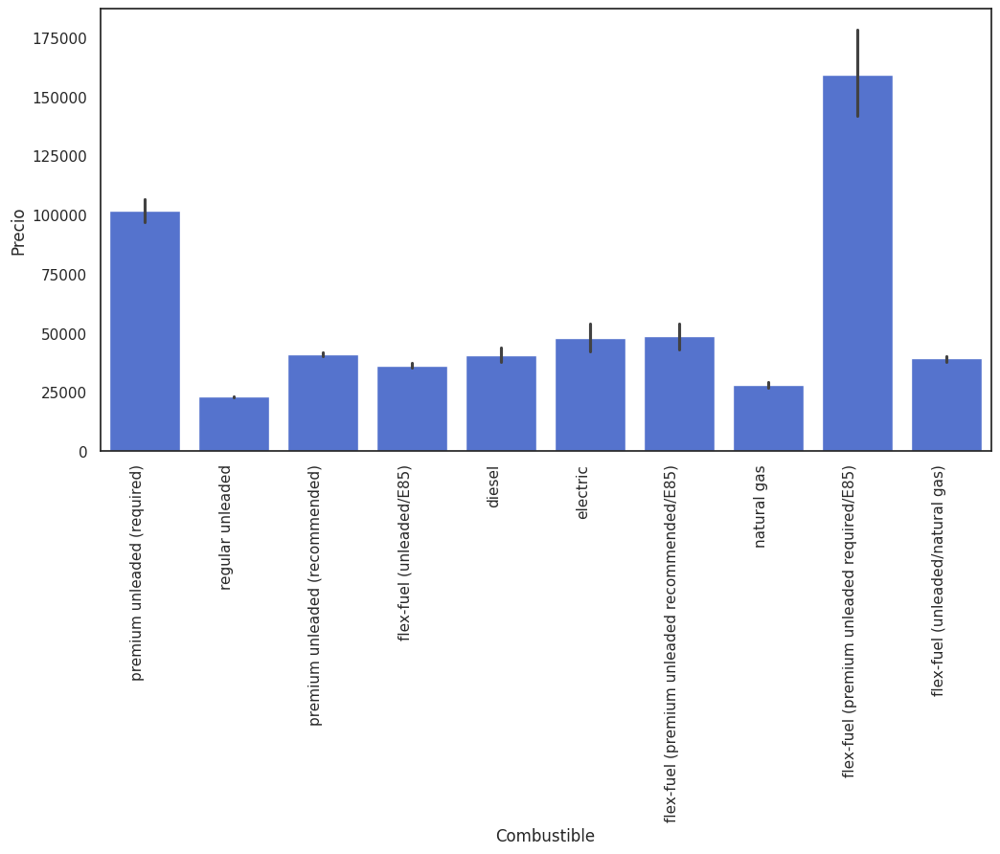

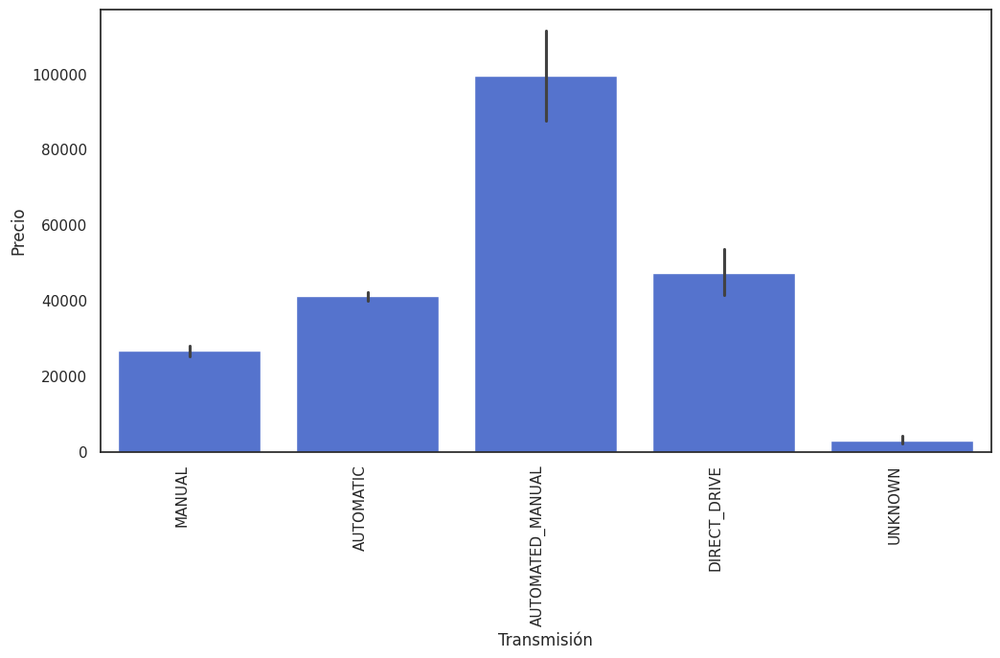

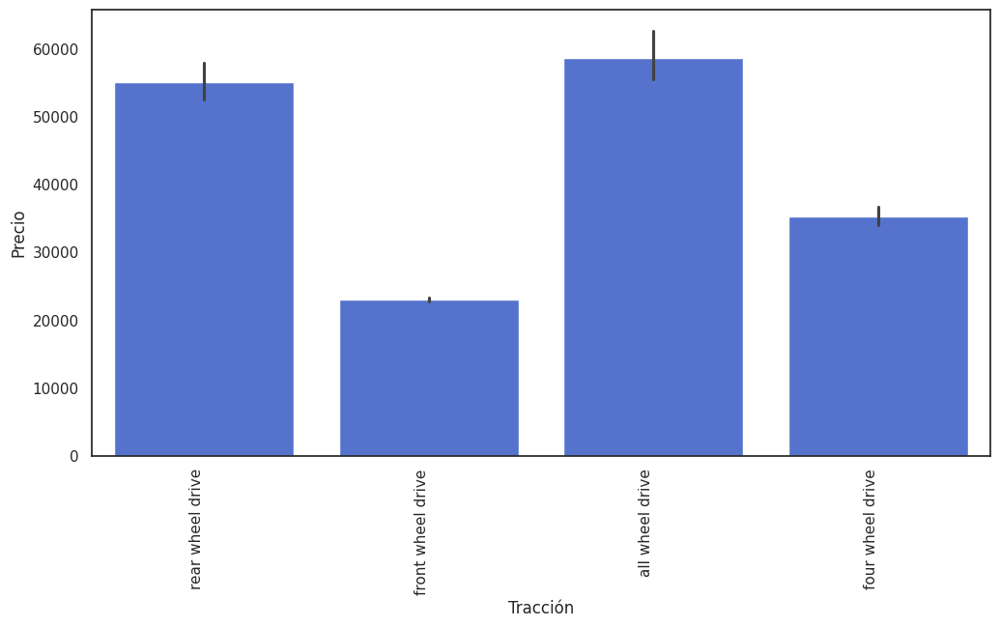

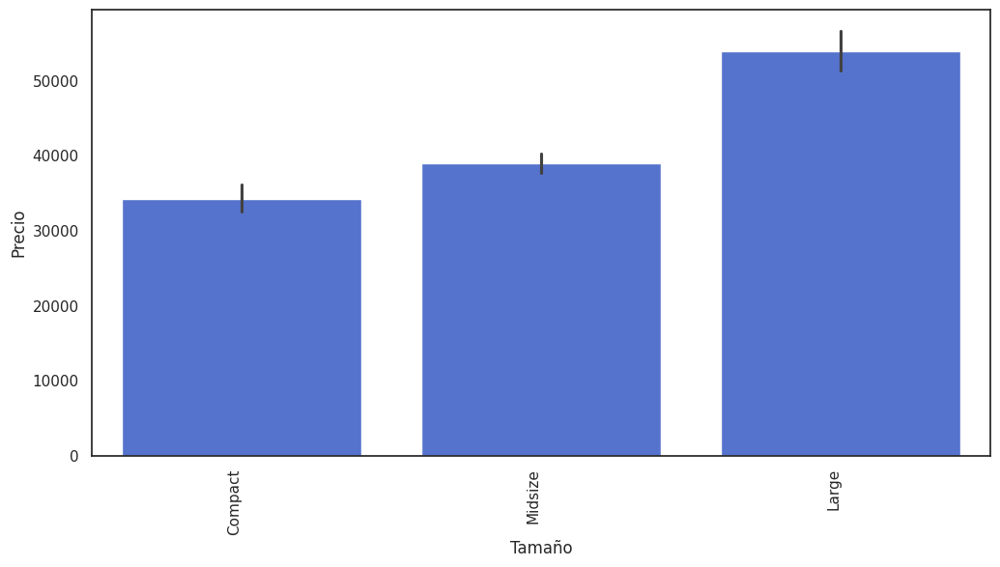

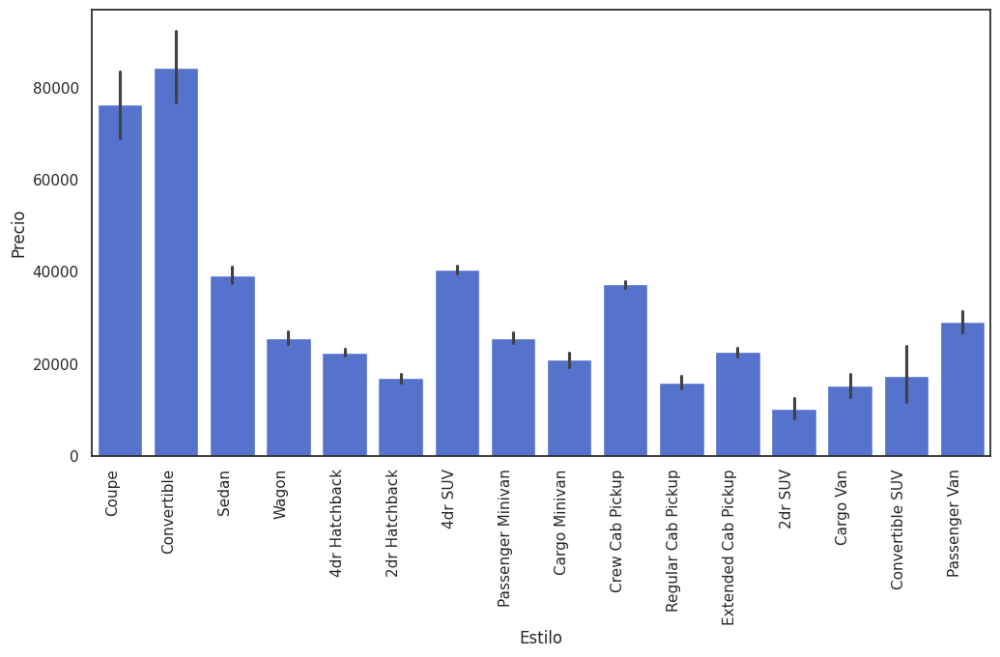

In [94]:
# BarPlot
for i in categoric_types.index:
    x_axis = categoric_types['Nombre'][i]
    y_axis = 'Precio'

    # Verificar si la columna es 'Modelo'
    if x_axis == 'Modelo':
        continue  # Saltar la iteración si es 'Modelo','Marca','Mercado' ya que tiene demasiados valores y no se observa la gráfica
    elif x_axis == 'Marca':
        continue
    elif x_axis == 'Mercado':
        continue
    fig, ax = plt.subplots(figsize=(12, 6))
    chart = sns.barplot(data=df, x=x_axis, y=y_axis, color='royalblue')
    chart.set_xticklabels(chart.get_xticklabels(), rotation=90, horizontalalignment='right')
    plt.show()

Observe por cada variable, si hay una distribución uniforme de los valores o no, que nos indique posibles relaciones.

#### 3.3.2 Variables Cuantitativas vs Variable Objetivo

Para conocer el comportamiento de las variables cuantitativas frente a la variable objetivo vamos a utilizar el ScatterPlot.

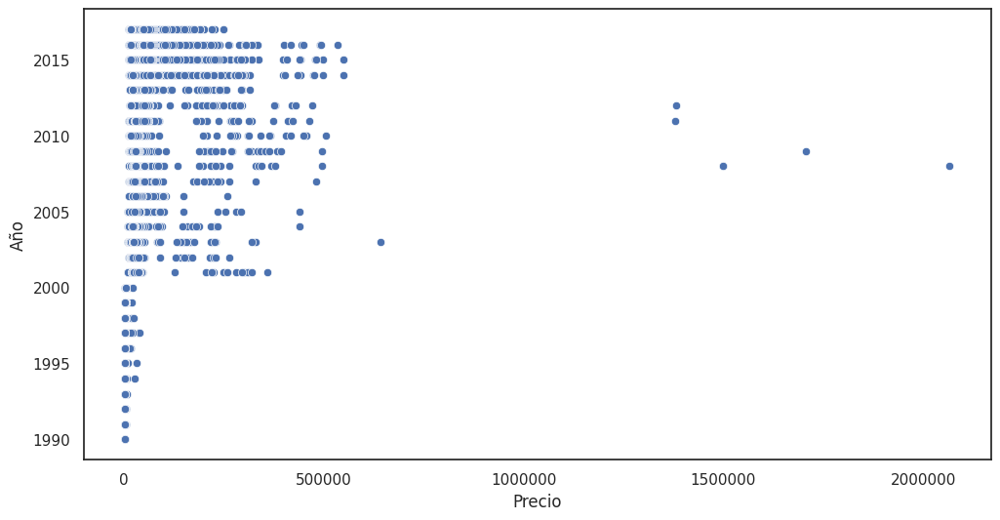

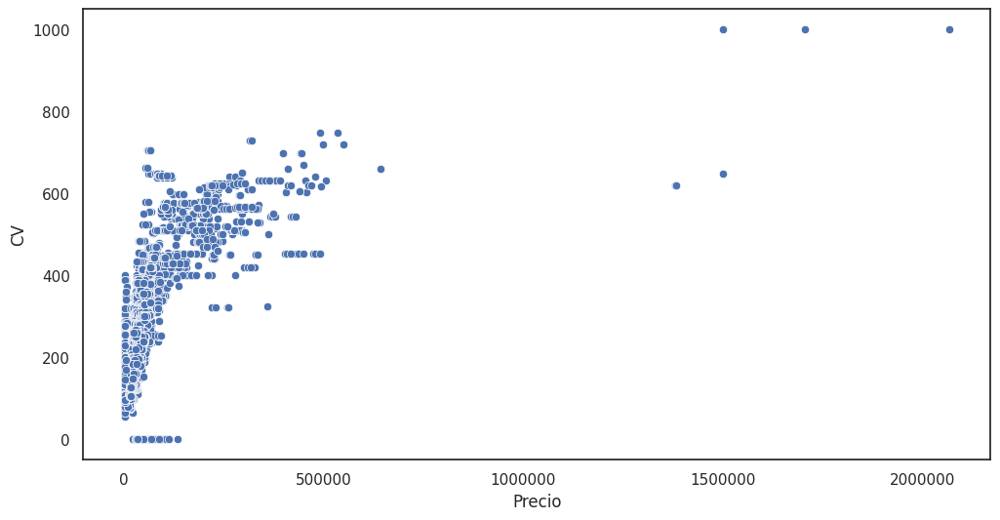

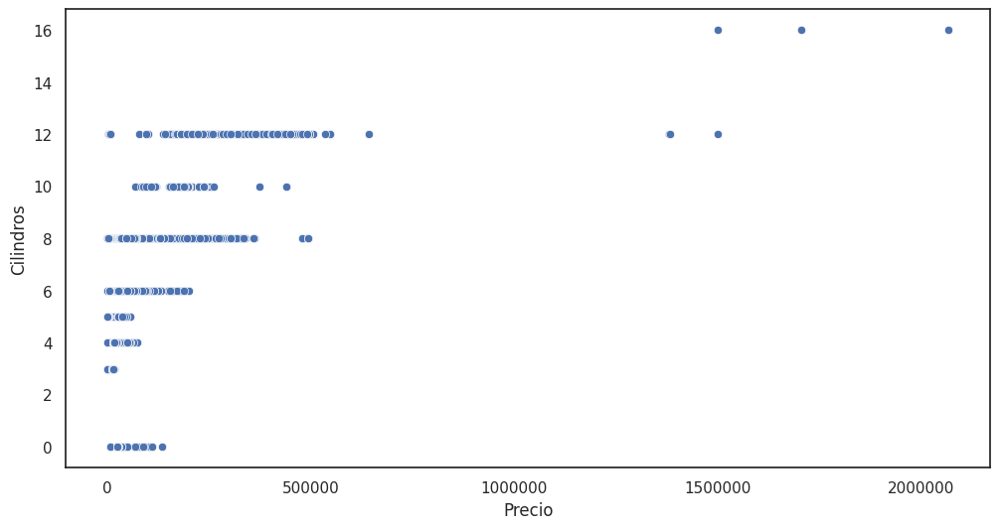

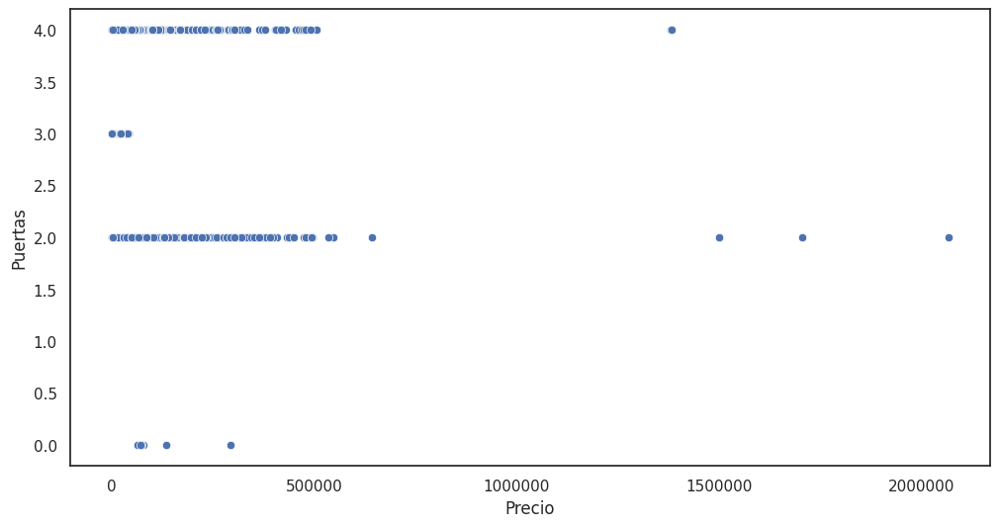

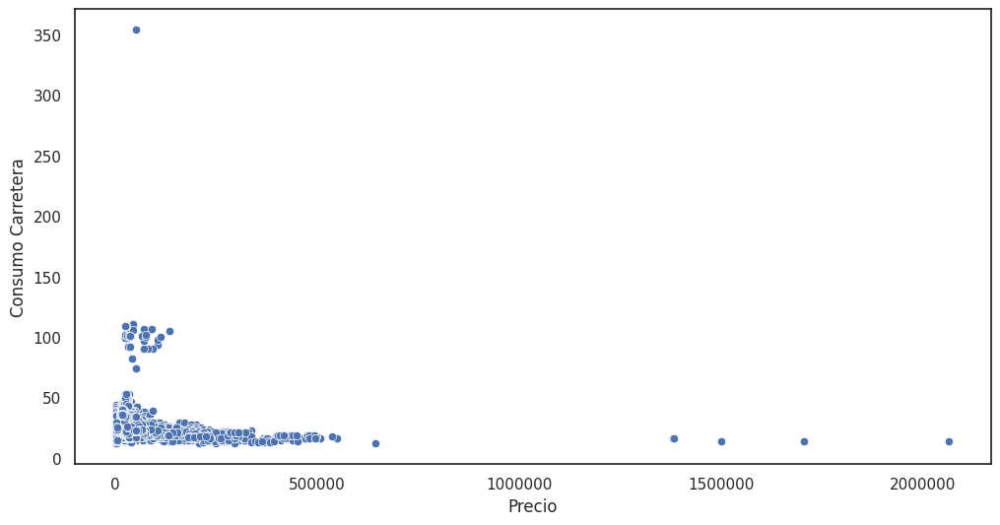

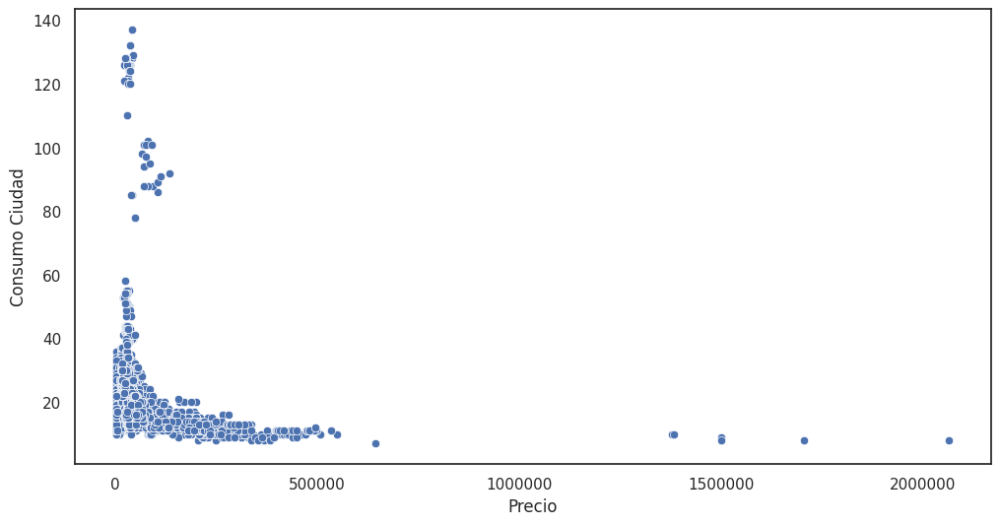

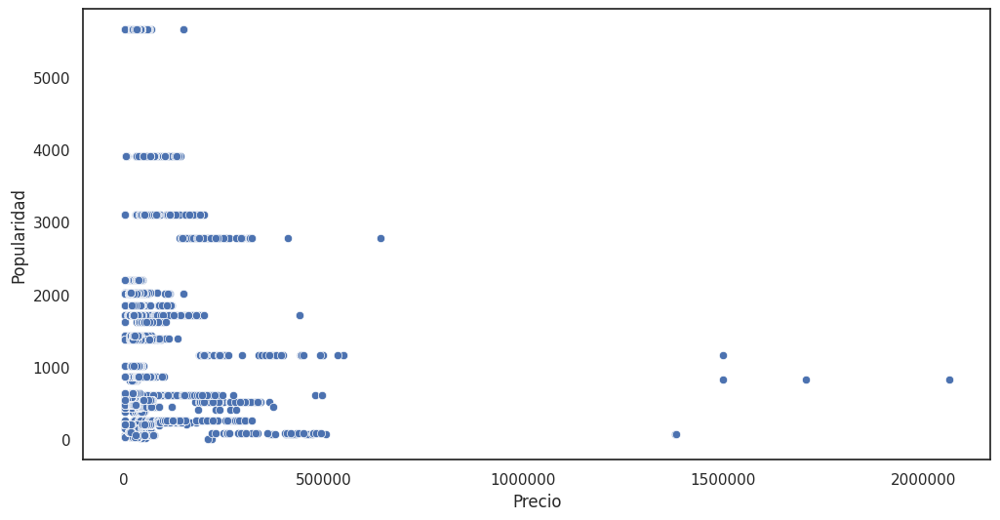

In [95]:
for i in numeric_types.index:
    x_axis = 'Precio'
    y_axis = numeric_types['Nombre'][i]

    # Verificar si la columna es 'Modelo'
    if y_axis == 'Precio':
        continue  # Saltar la iteración de la variable target
    fig, ax = plt.subplots(figsize=(12,6))
    chart = sns.scatterplot(data=df, x=x_axis, y=y_axis)
    # Formato de la escala del eje y para mostrar todos los ceros
    ax.xaxis.set_major_formatter(plt.FormatStrFormatter('%0.0f'))

    #chart.set_xticklabels(chart.get_xticklabels(), rotation=90, horizontalalignment='right')
    #plt.show()


Observe por cada variable, si hay una distribución uniforme de los valores o no, que nos indique posibles relaciones.

### 3.4. Análisis Multivariante

Tras el estudio frente a la variable objetivo, vamos a calcular la matriz de correlación para ver las dependencias entre variables cuantitativas.

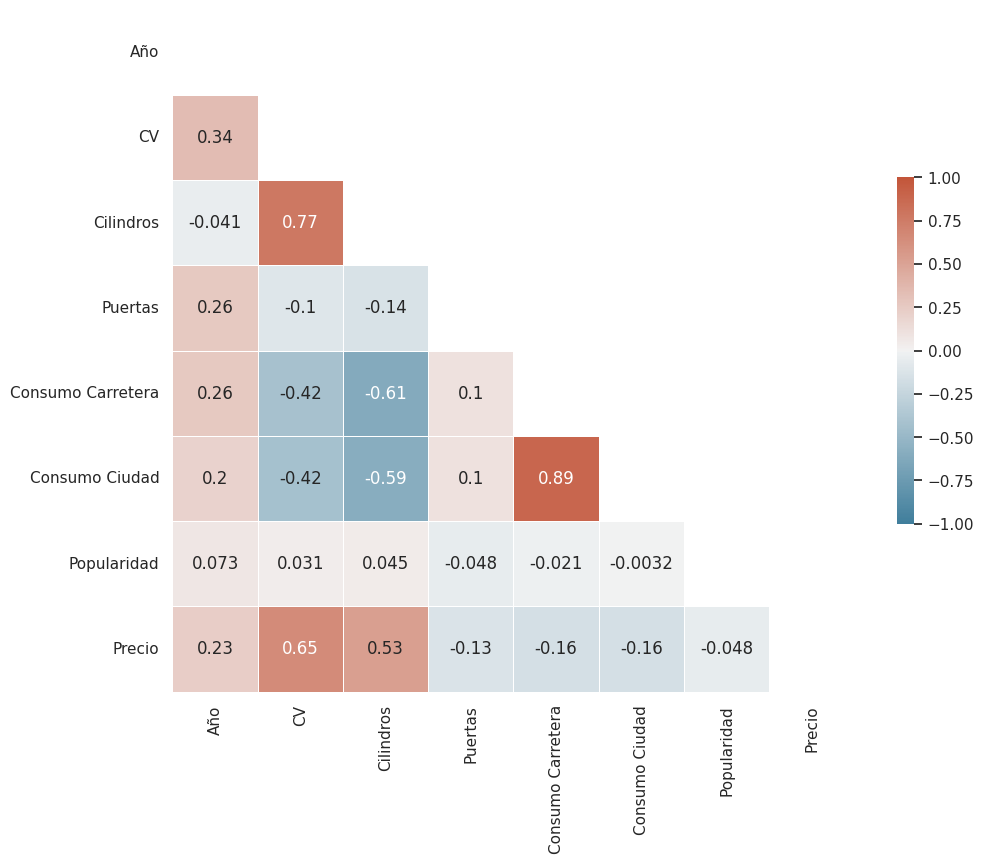

In [96]:
# Matriz de correlaciones de variables numéricas

numeric_df = df.select_dtypes(include=[np.number])
corr = numeric_df.corr()
mask = np.triu(np.ones_like(corr, dtype=bool))
f, ax = plt.subplots(figsize=(11, 9))
cmap = sns.diverging_palette(230, 20, as_cmap=True)
sns.set_theme(style="white")
# Draw the heatmap with the mask and correct aspect ratio
sns.heatmap(corr, annot=True, mask=mask, cmap=cmap, vmax=1, vmin=-1, center=0,
            square=True, linewidths=.5, cbar_kws={"shrink": .5});

Para analizar de forma gráfica, la relación entre dos variables cualitativas, podemos utilizar un heatmap de la siguiente forma:

Para analizar de forma gráfica, la relación entre dos variables cualitativas, podemos utilizar un heatmap de la siguiente forma:

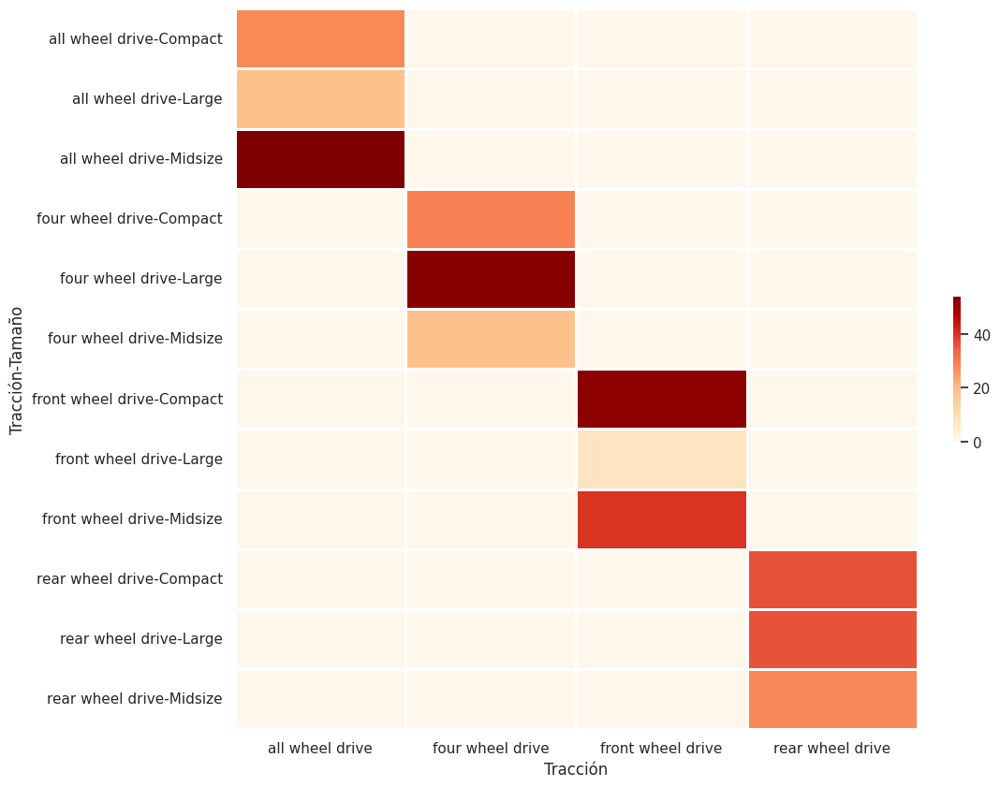

In [97]:
by_maker = (df
            .groupby(['Tamaño', 'Tracción'])
            .size()
            .groupby(level=1)
            .apply(lambda x: 100 * x / float(x.sum()))
            .unstack()
           )
by_maker.fillna(0, inplace=True)
plt.figure(figsize=(10,10))
g = sns.heatmap(
    by_maker,
    square=False, # make cells square
    cbar_kws={'fraction' : 0.01}, # shrink colour bar
    cmap='OrRd', # use orange/red colour map
    linewidth=1 # space between cells
)

### 3.5. Calidad del dato

#### 3.5.1 Detectar valores nulos

* Tener en cuenta que hemos detectado ya valores nulos en los campos 'CV', 'Cilindros' y 'Puertas' y les hemos asignado el valor '0' para poder transformar de una columna numerica continua a discreta.

Vamos a ver aquí el procedimiento que seguiríamos para detectarlos:

Procedimiento que seguiríamos para detectarlos:

In [98]:
# Observación de sumatoria de valores na en columnas
df.isna().sum()

Marca                   0
Modelo                  0
Año                     0
Combustible             3
CV                      0
Cilindros               0
Transmisión             0
Tracción                0
Puertas                 0
Mercado              3742
Tamaño                  0
Estilo                  0
Consumo Carretera       0
Consumo Ciudad          0
Popularidad             0
Precio                  0
dtype: int64

In [99]:
# Observación del porcentaje de valores na
porcentaje = df.isna().sum()/df.shape[0]
print(f'Porcentaje de valores perdidos:\n{porcentaje}')

Porcentaje de valores perdidos:
Marca               0.00
Modelo              0.00
Año                 0.00
Combustible         0.00
CV                  0.00
Cilindros           0.00
Transmisión         0.00
Tracción            0.00
Puertas             0.00
Mercado             0.31
Tamaño              0.00
Estilo              0.00
Consumo Carretera   0.00
Consumo Ciudad      0.00
Popularidad         0.00
Precio              0.00
dtype: float64


Se puede observar que la columna mercado posee mas de un 30% de valores na o valores perdidos.

Además, como se puede observar en las gráficas anteriores, los posibles valores que toma esta columna (además de ser muchos) tienen cierta relación entre sí.

Tambíen, este campo toma algunos valores similares al campo Combustible, como ser, Flex Fuel, Diesel, Electric, entr otros.

Por estos motivos, se decide prescindir de esta columna.

In [100]:
print("Número de filas válidas por columna:")
print(df.count().to_string())
print()

Número de filas válidas por columna:
Marca                11914
Modelo               11914
Año                  11914
Combustible          11911
CV                   11914
Cilindros            11914
Transmisión          11914
Tracción             11914
Puertas              11914
Mercado               8172
Tamaño               11914
Estilo               11914
Consumo Carretera    11914
Consumo Ciudad       11914
Popularidad          11914
Precio               11914



Si el valor que obtenemos es menor al número total de filas, es que existen nulos y deberíamos corregirlos en la fase de preparación de los datos.

Para el caso en concreto, recordemos que para las columnas 'CV', 'Cilindros' y 'Puertas' los valores 'na' serían los valores '0'.

**NOTA**: En la práctica, la fase de calidad y de preparación de datos se suele hacer o bien antes o durante el EDA, en el sentido de que es más cómodo ir corrigiendo los errores conforme nos los vamos encontrando.

#### 3.5.2 Detectar valores atípicos

Analizamos los valores atípicos de las variables cuantitativas para descartarlos posteriormente.

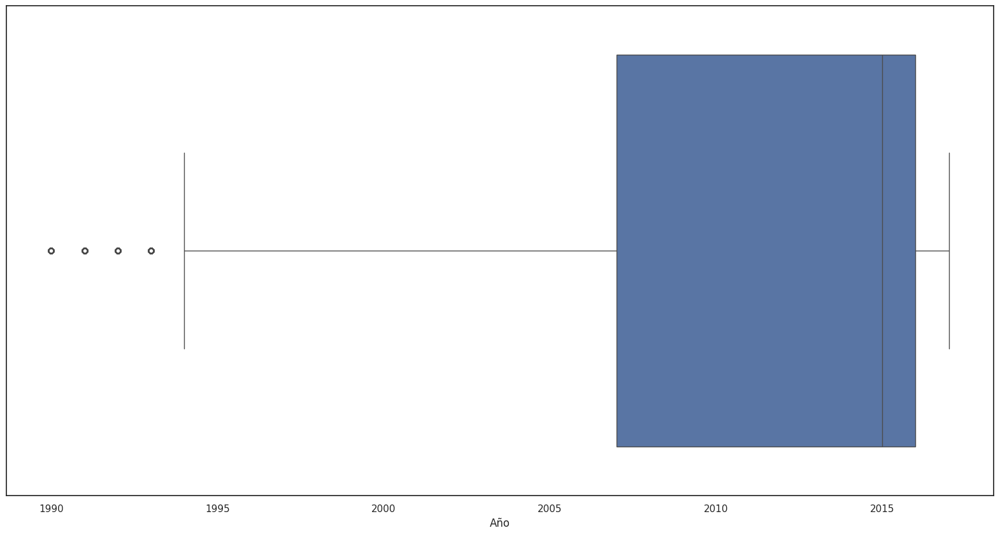

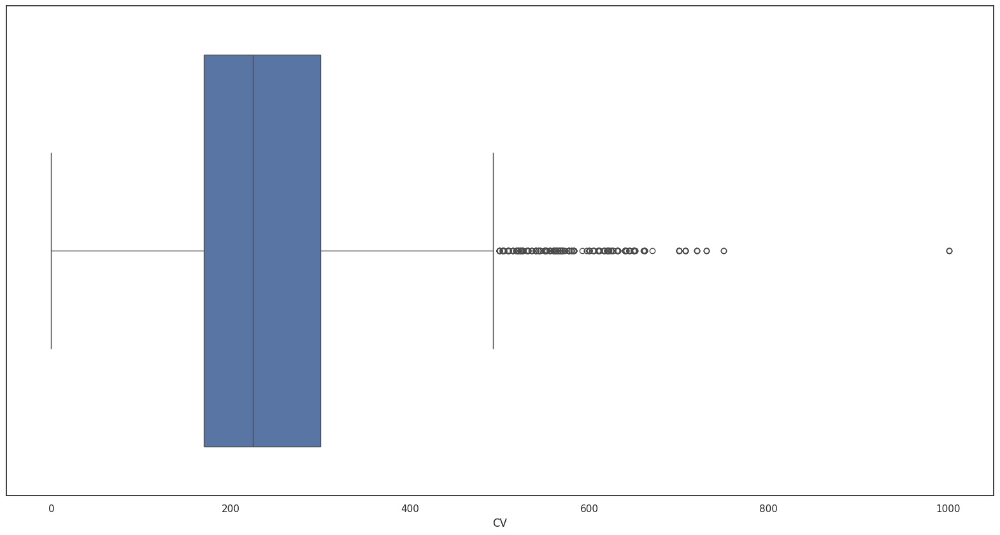

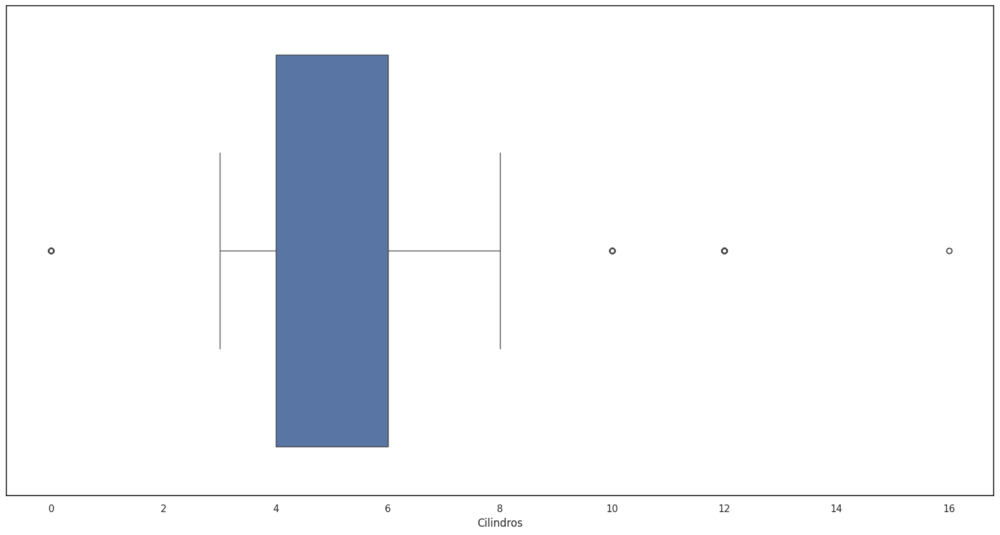

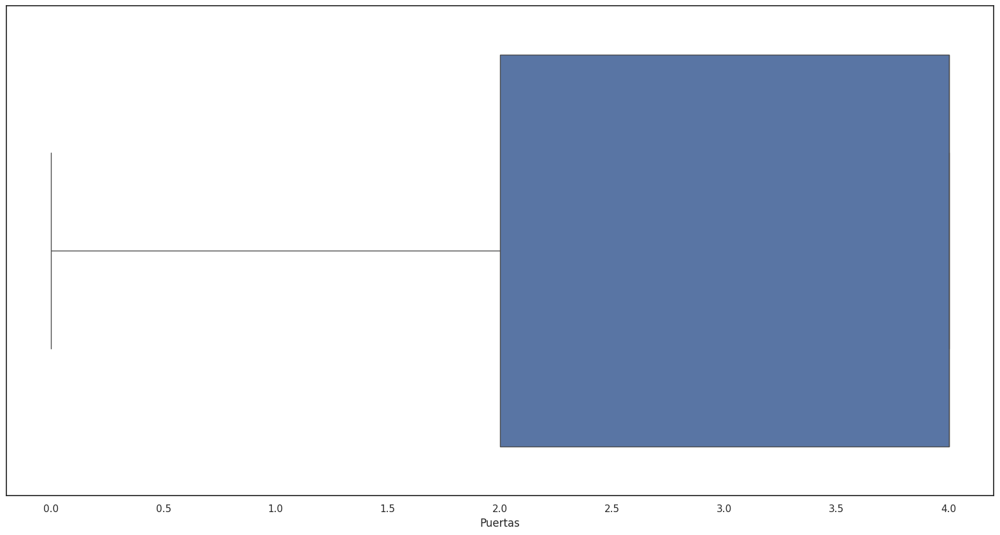

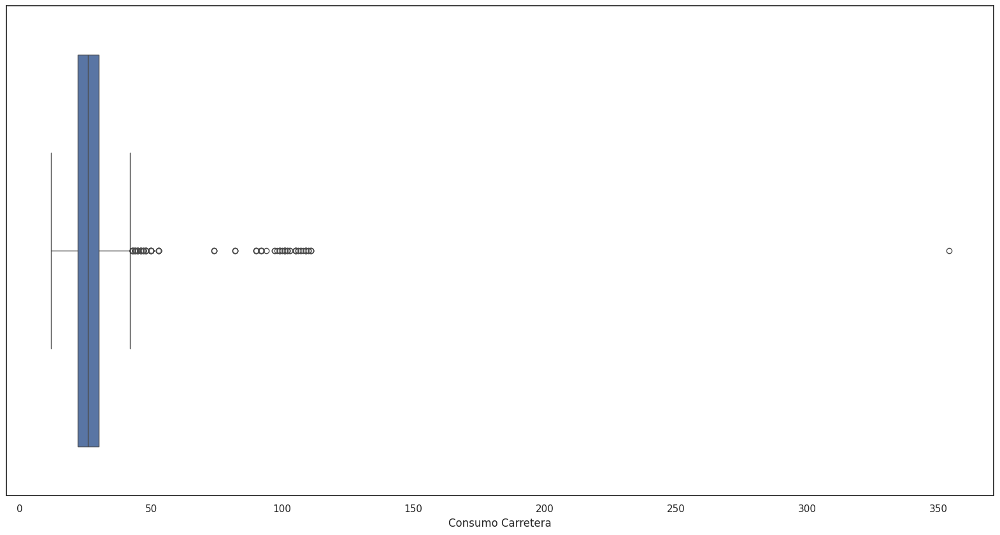

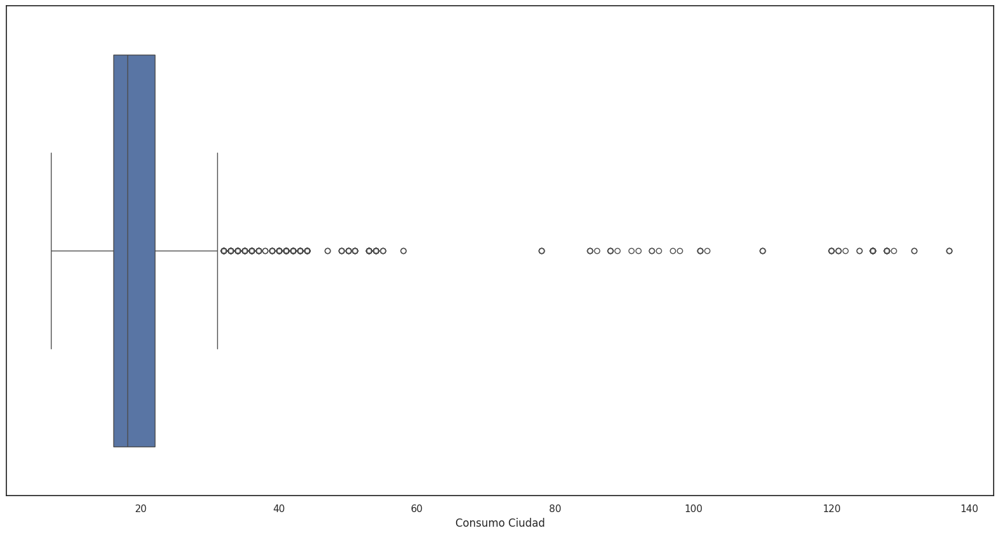

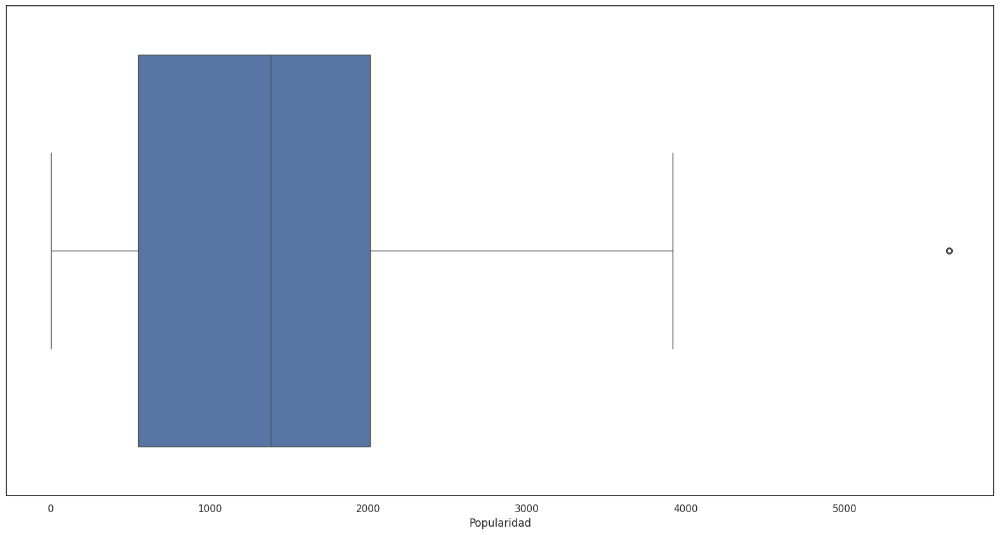

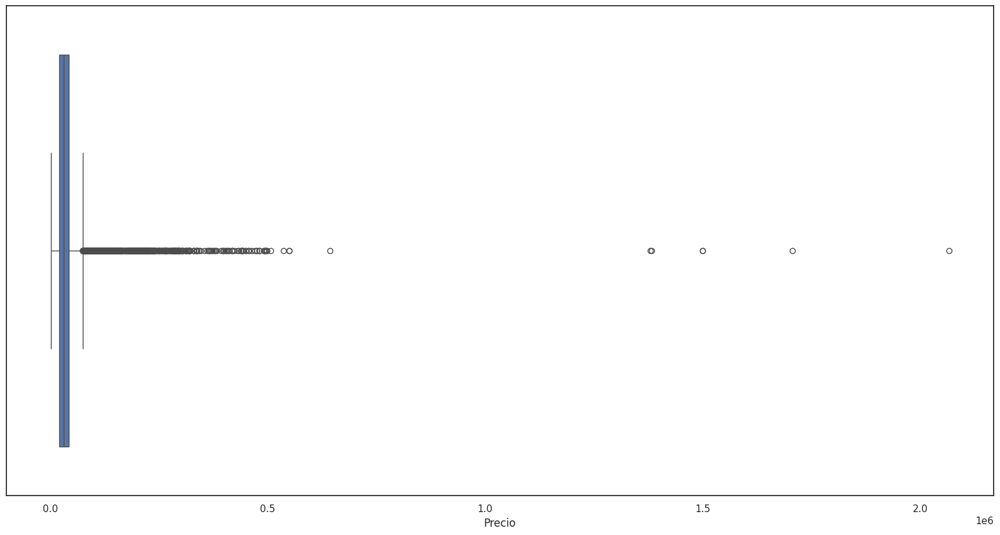

In [101]:
for i, column in enumerate(numeric_df.columns):
  fig, axs = plt.subplots(figsize=(20,10))
  sns.boxplot(x=df[column])

## 4. Preparación de los datos

### 4.1. Seleccionar los datos

Seleccionamos las variables que son de nuestro interés. En este caso vamos a descartar el campo 'Mercado'              

In [102]:
df = df.drop(['Mercado'], axis=1, errors='ignore')
data_table.DataTable(df, include_index=False, num_rows_per_page=5)

,Marca,Modelo,Año,Combustible,CV,Cilindros,Transmisión,Tracción,Puertas,Tamaño,Estilo,Consumo Carretera,Consumo Ciudad,Popularidad,Precio
0,BMW,1 Series M,2011,premium unleaded (required),335,6,MANUAL,rear wheel drive,2,Compact,Coupe,26.00,19.00,3916,46135.00
1,BMW,1 Series,2011,premium unleaded (required),300,6,MANUAL,rear wheel drive,2,Compact,Convertible,28.00,19.00,3916,40650.00
2,BMW,1 Series,2011,premium unleaded (required),300,6,MANUAL,rear wheel drive,2,Compact,Coupe,28.00,20.00,3916,36350.00
3,BMW,1 Series,2011,premium unleaded (required),230,6,MANUAL,rear wheel drive,2,Compact,Coupe,28.00,18.00,3916,29450.00
4,BMW,1 Series,2011,premium unleaded (required),230,6,MANUAL,rear wheel drive,2,Compact,Convertible,28.00,18.00,3916,34500.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
11909,Acura,ZDX,2012,premium unleaded (required),300,6,AUTOMATIC,all wheel drive,4,Midsize,4dr Hatchback,23.00,16.00,204,46120.00
11910,Acura,ZDX,2012,premium unleaded (required),300,6,AUTOMATIC,all wheel drive,4,Midsize,4dr Hatchback,23.00,16.00,204,56670.00
11911,Acura,ZDX,2012,premium unleaded (required),300,6,AUTOMATIC,all wheel drive,4,Midsize,4dr Hatchback,23.00,16.00,204,50620.00
11912,Acura,ZDX,2013,premium unleaded (recommended),300,6,AUTOMATIC,all wheel drive,4,Midsize,4dr Hatchback,23.00,16.00,204,50920.00


### 4.1.2 Modificación variables
Con las siguienes modificaciones se buscará reducir las variables con múchas categorias.

In [103]:
# Observación más detallada de los valores de las columnas antes de cambios
columns_to_modify = ['Combustible','Tracción', 'Transmisión']
for col in columns_to_modify:
    print(f"{col}: {df[col].unique()}\n")

Combustible: ['premium unleaded (required)' 'regular unleaded'
 'premium unleaded (recommended)' 'flex-fuel (unleaded/E85)' 'diesel'
 'electric' 'flex-fuel (premium unleaded recommended/E85)' 'natural gas'
 'flex-fuel (premium unleaded required/E85)'
 'flex-fuel (unleaded/natural gas)' nan]

Tracción: ['rear wheel drive' 'front wheel drive' 'all wheel drive'
 'four wheel drive']

Transmisión: ['MANUAL' 'AUTOMATIC' 'AUTOMATED_MANUAL' 'DIRECT_DRIVE' 'UNKNOWN']



In [104]:
# Variable 'Combustible'
df['Combustible'] = df['Combustible'].replace({
    'premium unleaded (required)': 'premium unleaded',
    'premium unleaded (recommended)': 'premium unleaded',
    'flex-fuel (unleaded/E85)': 'flex-fuel',
    'flex-fuel (premium unleaded recommended/E85)': 'flex-fuel',
    'flex-fuel (premium unleaded required/E85)': 'flex-fuel',
    'flex-fuel (unleaded/natural gas)': 'flex-fuel'
})
df['Combustible'].unique()

array(['premium unleaded', 'regular unleaded', 'flex-fuel', 'diesel',
       'electric', 'natural gas', nan], dtype=object)

In [105]:
# Variable 'Tracción'
df['Tracción'] = df['Tracción'].replace({
    'rear wheel drive': 'rear',
    'front wheel drive': 'front',
    'all wheel drive': 'all',
    'four wheel drive': 'all'
})
df['Tracción'].unique()

array(['rear', 'front', 'all'], dtype=object)

In [106]:
# Obtener todos los valores únicos de la columna 'Transmisión'
transmission_values = df['Transmisión'].unique()

# Iterar sobre cada valor único
for transmission in transmission_values:
    # Contar cuántas veces aparece el valor actual de 'Transmisión'
    count_transmission = (df['Transmisión'] == transmission).sum()

    # Imprimir el resultado
    print(f"Transmisión: {transmission} - Count: {count_transmission}")

Transmisión: MANUAL - Count: 2935
Transmisión: AUTOMATIC - Count: 8266
Transmisión: AUTOMATED_MANUAL - Count: 626
Transmisión: DIRECT_DRIVE - Count: 68
Transmisión: UNKNOWN - Count: 19


Se decide eliminar las categorias:
* UNKNOWN: Representa pocos valores. Se desea saber el tipo de Transmisión del coche.

In [107]:
df = df[(df['Transmisión'] != 'UNKNOWN')]

In [108]:
# Variable 'Transmisión'
df['Transmisión'] = df['Transmisión'].replace({
    'MANUAL': 'manual',
    'AUTOMATIC': 'automatic',
    'AUTOMATED_MANUAL': 'automated-manual',
    'DIRECT_DRIVE': 'direct-drive'
})
df['Transmisión'].unique()

array(['manual', 'automatic', 'automated-manual', 'direct-drive'],
      dtype=object)

In [109]:
for col in df.columns:
    print(f"{col}: {df[col].unique()}\n")

Marca: ['BMW' 'Audi' 'FIAT' 'Mercedes-Benz' 'Chrysler' 'Nissan' 'Volvo' 'Mazda'
 'Mitsubishi' 'Ferrari' 'Alfa Romeo' 'Toyota' 'McLaren' 'Maybach'
 'Pontiac' 'Porsche' 'Saab' 'GMC' 'Hyundai' 'Plymouth' 'Honda'
 'Oldsmobile' 'Suzuki' 'Ford' 'Cadillac' 'Kia' 'Bentley' 'Chevrolet'
 'Dodge' 'Lamborghini' 'Lincoln' 'Subaru' 'Volkswagen' 'Spyker' 'Buick'
 'Acura' 'Rolls-Royce' 'Maserati' 'Lexus' 'Aston Martin' 'Land Rover'
 'Lotus' 'Infiniti' 'Scion' 'Genesis' 'HUMMER' 'Tesla' 'Bugatti']

Modelo: ['1 Series M' '1 Series' '100' '124 Spider' '190-Class' '2 Series' '200'
 '200SX' '240SX' '240' '2' '3 Series Gran Turismo' '3 Series' '300-Class'
 '3000GT' '300' '300M' '300ZX' '323' '350-Class' '350Z' '360' '370Z' '3'
 '4 Series Gran Coupe' '4 Series' '400-Class' '420-Class' '456M'
 '458 Italia' '4C' '4Runner' '5 Series Gran Turismo' '5 Series'
 '500-Class' '500e' '500' '500L' '500X' '550' '560-Class' '570S' '575M'
 '57' '599' '5' '6 Series Gran Coupe' '6 Series' '600-Class' '6000'
 '612 Scaglietti

### 4.2 Limpieza de datos

#### 4.2.1 Eliminar nulos

Para eliminar los nulos utilizaremos el siguiente código:

In [110]:
print("Eliminando datos nulos:")
print()
df = df.dropna().reset_index(drop=True)
print("Número de filas válidas por columna:")
print(df.count().to_string())

Eliminando datos nulos:

Número de filas válidas por columna:
Marca                11892
Modelo               11892
Año                  11892
Combustible          11892
CV                   11892
Cilindros            11892
Transmisión          11892
Tracción             11892
Puertas              11892
Tamaño               11892
Estilo               11892
Consumo Carretera    11892
Consumo Ciudad       11892
Popularidad          11892
Precio               11892


Para eliminar los valores '0' de las columnas CV, Cilindros, Puertas utilizaremos el siguiente código:

In [111]:
# Eliminar los registros con valor 0 en las columnas
colums = ['CV','Cilindros','Puertas']
for col in colums:
  df = df[df[col] != 0]

# Resetear el índice después de eliminar los registros
df.reset_index(drop=True, inplace=True)

df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 11780 entries, 0 to 11779
Data columns (total 15 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   Marca              11780 non-null  object 
 1   Modelo             11780 non-null  object 
 2   Año                11780 non-null  int64  
 3   Combustible        11780 non-null  object 
 4   CV                 11780 non-null  int64  
 5   Cilindros          11780 non-null  int64  
 6   Transmisión        11780 non-null  object 
 7   Tracción           11780 non-null  object 
 8   Puertas            11780 non-null  int64  
 9   Tamaño             11780 non-null  object 
 10  Estilo             11780 non-null  object 
 11  Consumo Carretera  11780 non-null  float64
 12  Consumo Ciudad     11780 non-null  float64
 13  Popularidad        11780 non-null  int64  
 14  Precio             11780 non-null  float64
dtypes: float64(3), int64(5), object(7)
memory usage: 1.3+ MB


#### 4.2.2 Eliminar registros duplicados

In [112]:
print(f"Número de filas: {df.shape[0]}")
print(f"Número de columnas: {df.shape[1]}")
print()
print("Eliminando filas con valores duplicados...")
# Eliminamos todos aquellos registros que en TODAS SUS COLUMNAS tienen el mismo valor, quedandose con un único registro.
df = df.drop_duplicates()
df.reset_index(drop=True, inplace=True)
print()
print(f"Número de filas: {df.shape[0]}")
print(f"Número de columnas: {df.shape[1]}")

Número de filas: 11780
Número de columnas: 15

Eliminando filas con valores duplicados...

Número de filas: 11062
Número de columnas: 15


#### 4.2.3 Eliminar valores atípicos

Con el siguiente código eliminamos los valores atípicos indicando los nombres de las columnas en el vector *columns_with_outliers*

Número de filas (con valores atípicos): 11062
Eliminando valores atípicos...
Número de filas (sin valores atípicos): 8602

Datos Cuantitativos:
           Nombre      Tipo de variable    Media  Mínimo   Máximo  Mediana
              Año Cuantitativa discreta  2011.31 1994.00  2017.00  2015.00
               CV Cuantitativa discreta   235.73   66.00   485.00   230.00
        Cilindros Cuantitativa discreta     5.39    3.00     8.00     6.00
          Puertas Cuantitativa discreta     3.54    2.00     4.00     4.00
Consumo Carretera Cuantitativa continua    26.68   13.00    42.00    26.00
   Consumo Ciudad Cuantitativa continua    19.43   10.00    31.00    19.00
      Popularidad Cuantitativa discreta  1211.65   21.00  3916.00  1013.00
           Precio Cuantitativa continua 31030.89 2000.00 75300.00 29985.00



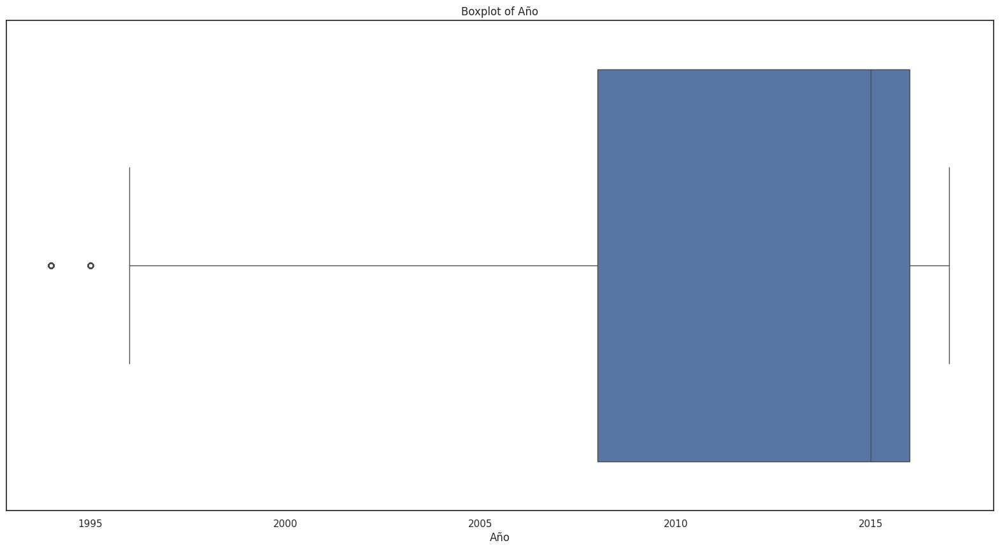

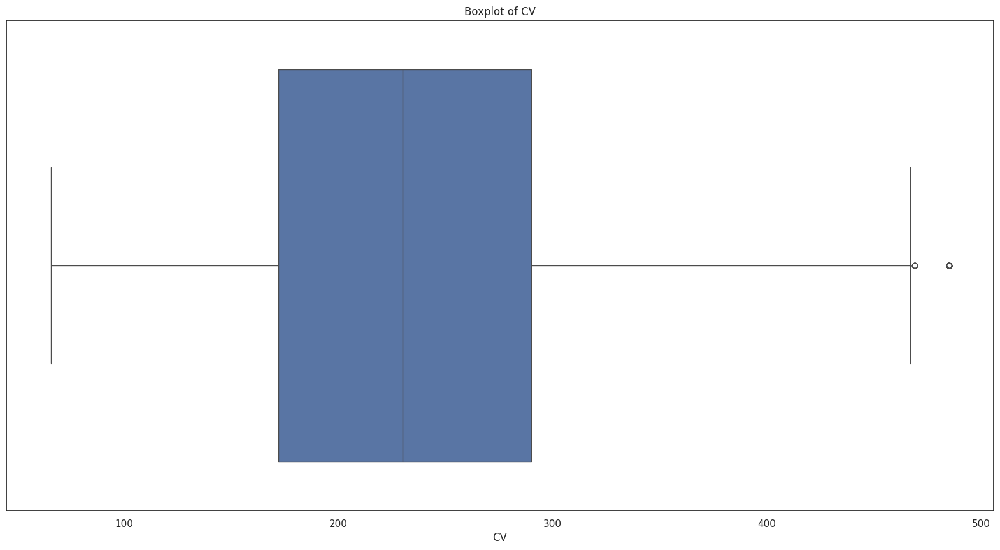

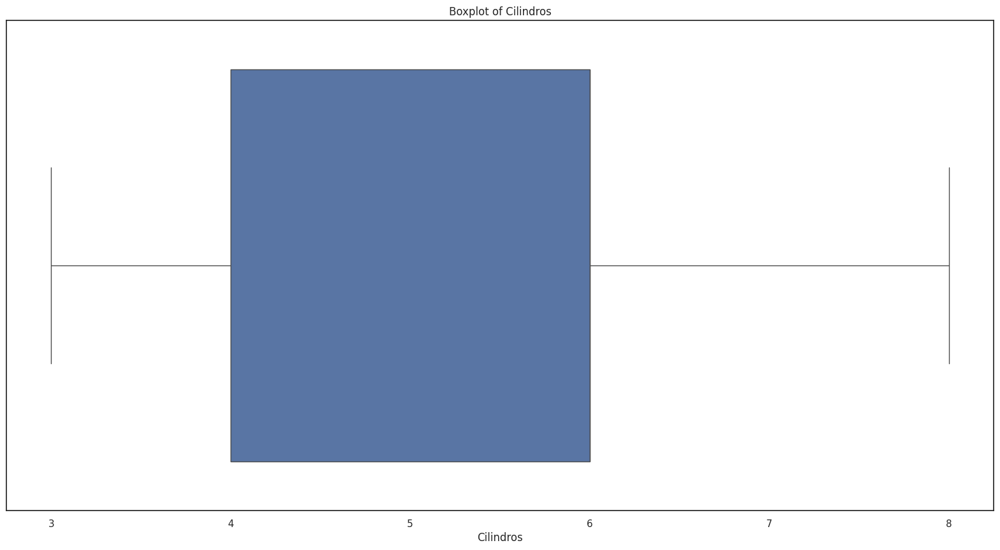

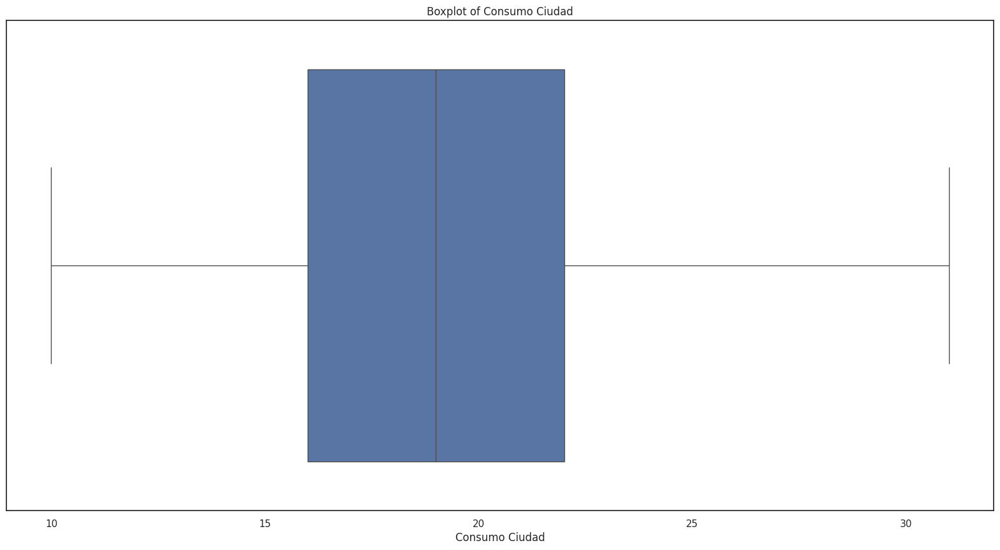

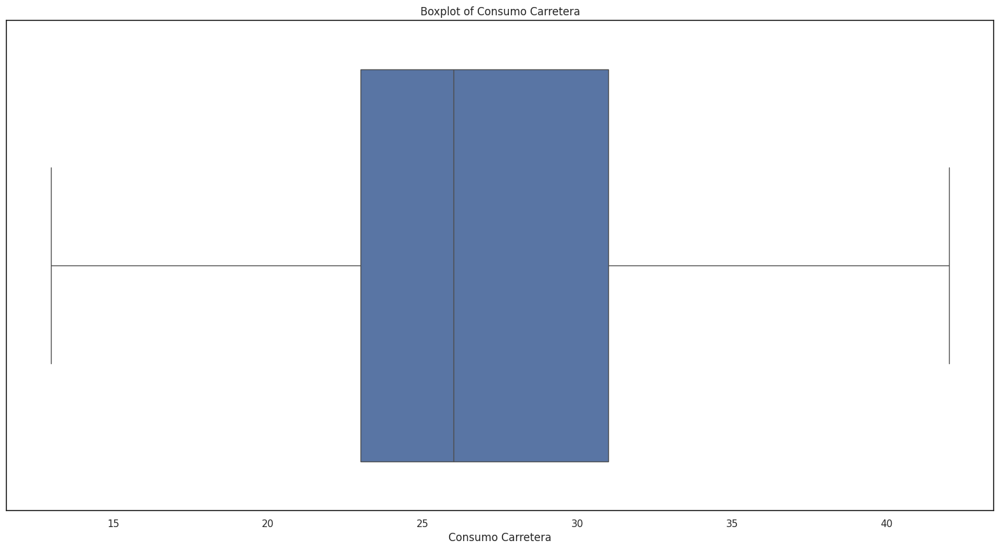

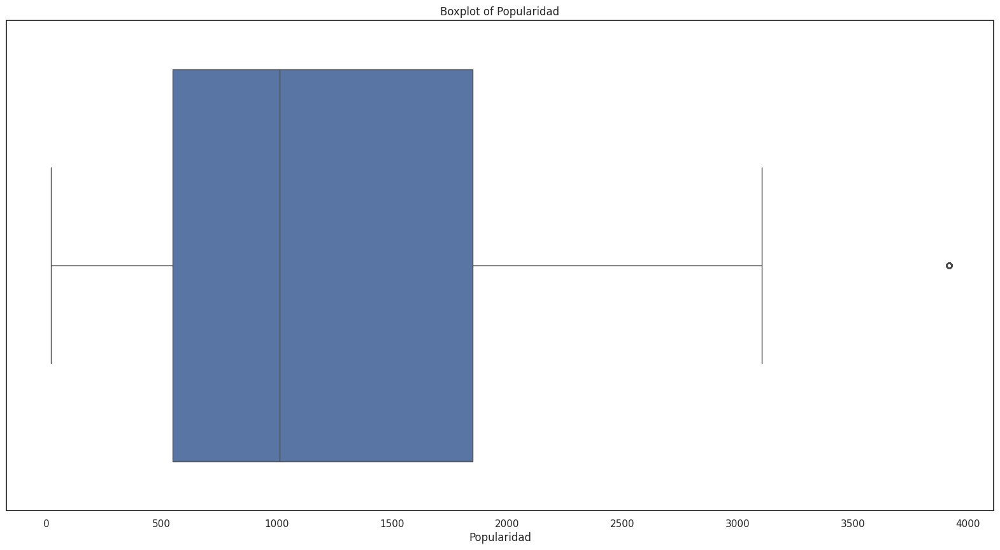

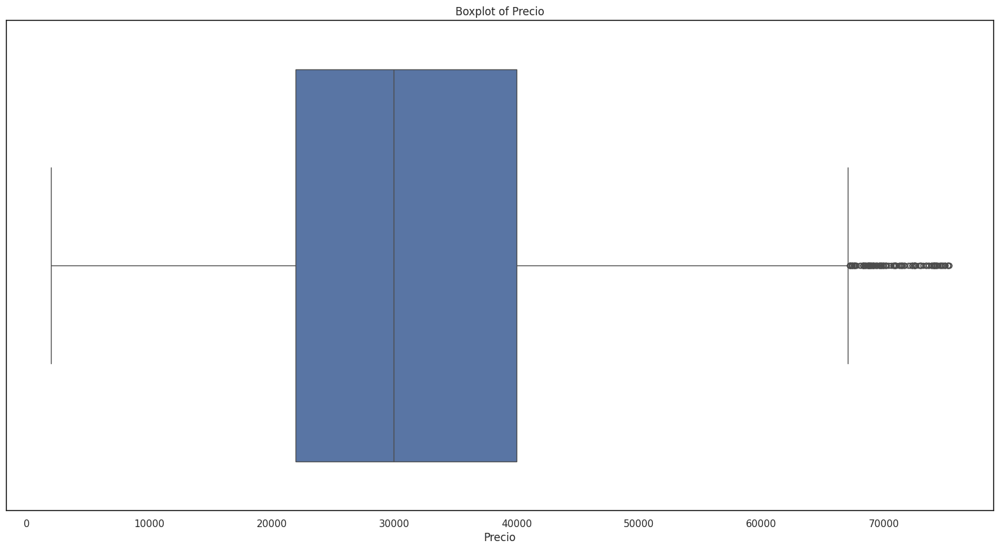

In [113]:
# columns_with_outliers son las columnas donde se buscarán los valores atípicos

columns_with_outliers = ['Año', 'CV', 'Cilindros', 'Consumo Ciudad', 'Consumo Carretera', 'Popularidad', 'Precio']

print(f"Número de filas (con valores atípicos): {df.shape[0]}")
print("Eliminando valores atípicos...")

# Calcular los cuartiles y el IQR para las columnas especificadas
Q1 = df[columns_with_outliers].quantile(0.25)
Q3 = df[columns_with_outliers].quantile(0.75)
IQR = Q3 - Q1

# Aplicar la condición para filtrar los valores atípicos
condition = ~((df[columns_with_outliers] < (Q1 - 1.5 * IQR)) | (df[columns_with_outliers] > (Q3 + 1.5 * IQR))).any(axis=1)
df2 = df[condition]
df2.reset_index(drop=True, inplace=True)

print(f"Número de filas (sin valores atípicos): {df2.shape[0]}")

numeric_types, categoric_types = analyze_df(df2)
print("\nDatos Cuantitativos:")
print(numeric_types.to_string(index=False))
print()

# Generar gráficos de cajas para las columnas con valores atípicos
for column in columns_with_outliers:
    fig, axs = plt.subplots(figsize=(20, 10))
    sns.boxplot(x=df2[column])
    plt.title(f'Boxplot of {column}')
    plt.show()

### 4.3. Formatear

Como la mayor parte de modelos de machine learning en scikit-learn necesitan variables numéricas para funcionar, vamos a utilizar una técnica de codificación que nos permite transformar variabels categóricas en numéricas.

In [114]:
df2.columns

Index(['Marca', 'Modelo', 'Año', 'Combustible', 'CV', 'Cilindros',
       'Transmisión', 'Tracción', 'Puertas', 'Tamaño', 'Estilo',
       'Consumo Carretera', 'Consumo Ciudad', 'Popularidad', 'Precio'],
      dtype='object')

In [115]:
# Definimos las columnas categoricas
categorical_columns = ['Modelo', 'Marca', 'Combustible','Transmisión','Tracción','Tamaño','Estilo']

# Inicializamos label encoder
label_encoder = LabelEncoder()

# Iteramos para columnas categoricas
for column in categorical_columns:
  df2[column] = label_encoder.fit_transform(df2[column])

data_table.DataTable(df2, include_index=False, num_rows_per_page=5)



,Marca,Modelo,Año,Combustible,CV,Cilindros,Transmisión,Tracción,Puertas,Tamaño,Estilo,Consumo Carretera,Consumo Ciudad,Popularidad,Precio
0,3,1,2011,3,335,6,2,2,2,0,8,26.00,19.00,3916,46135.00
1,3,0,2011,3,300,6,2,2,2,0,6,28.00,19.00,3916,40650.00
2,3,0,2011,3,300,6,2,2,2,0,8,28.00,20.00,3916,36350.00
3,3,0,2011,3,230,6,2,2,2,0,8,28.00,18.00,3916,29450.00
4,3,0,2011,3,230,6,2,2,2,0,6,28.00,18.00,3916,34500.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
8597,0,636,2012,3,300,6,1,0,4,2,2,23.00,16.00,204,46120.00
8598,0,636,2012,3,300,6,1,0,4,2,2,23.00,16.00,204,56670.00
8599,0,636,2012,3,300,6,1,0,4,2,2,23.00,16.00,204,50620.00
8600,0,636,2013,3,300,6,1,0,4,2,2,23.00,16.00,204,50920.00


Probemos ahora a detectar posibles correlaciones:

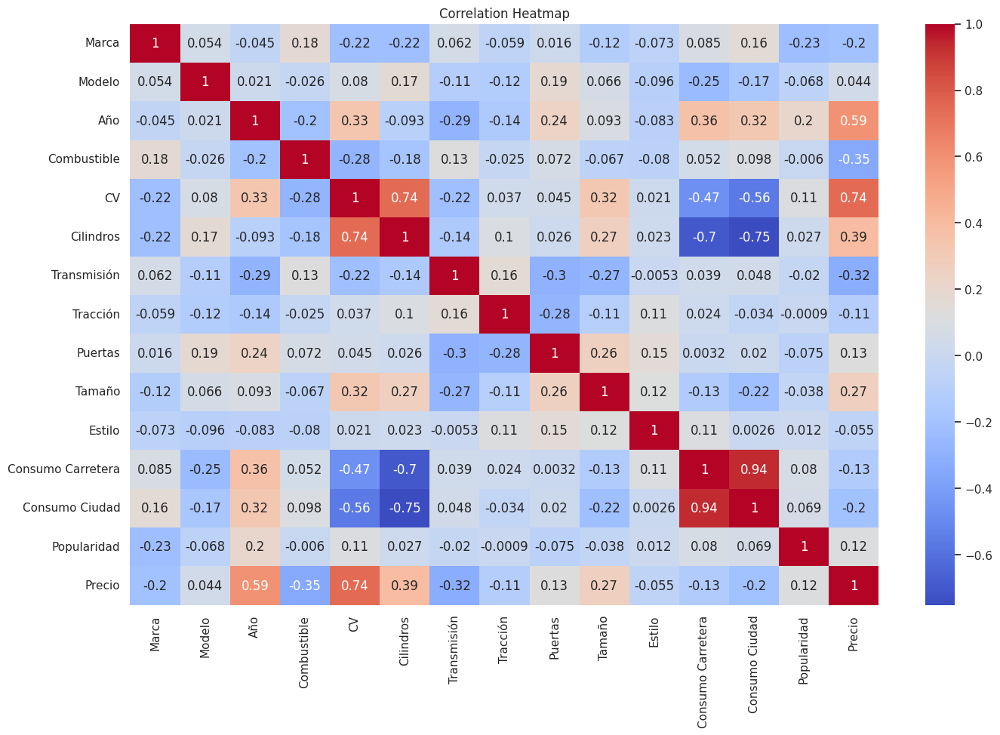

In [116]:
correlation_matrix = df2.corr()
plt.figure(figsize=(16, 10))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm')
plt.title('Correlation Heatmap')
plt.show()

Como se puede observar las variables **'Año' y 'CV'** son las que más correlacionadas se encuentran con nuestra variable objetivo **Precio**.

## 5. Desarrollo y Evaluación del modelo

Como queremos estimar una variable cuantitativa, es un problema de regresión y siguiendo la guía de scikit-learn:
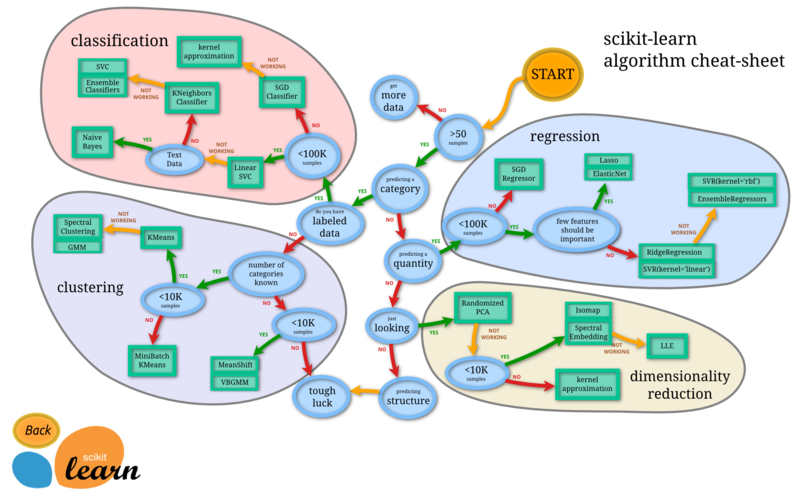



### 5.1 Regresión Lineal Simple

Vamos a probar lo más sencillo, que es utilizar una regresión lineal con la variable explicativa que más correlación presenta (CV):

Error cuadrático medio (MSE): 0.0178
Coeficiente de determinación (R2): 0.5666


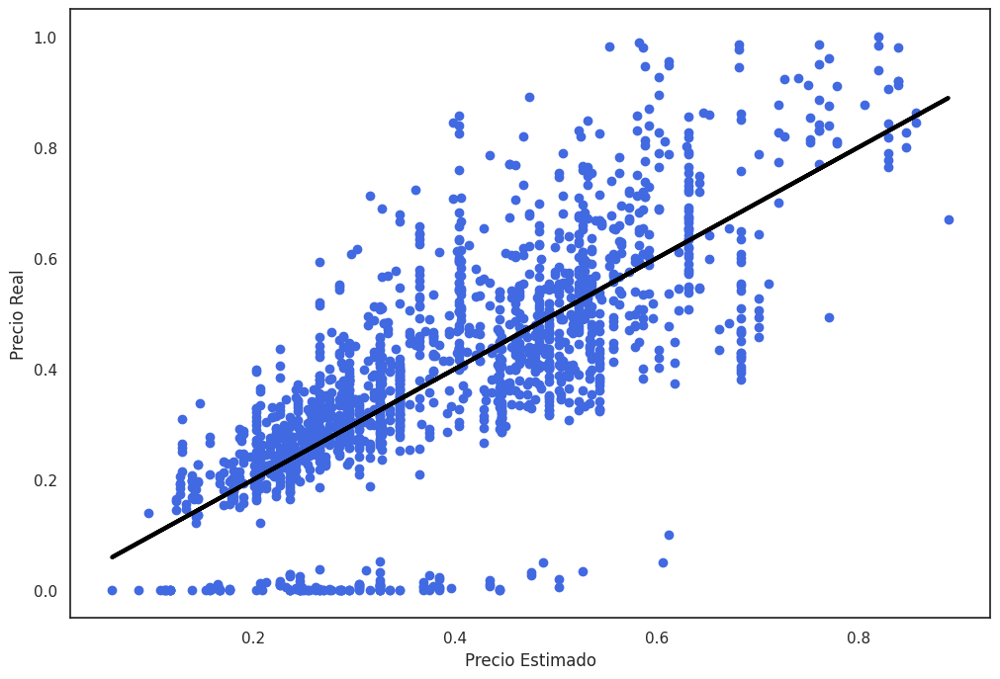

In [117]:
x_cols = ['CV']
y_cols = ['Precio']

# Normalizamos las dos variables, para poder interpretar mejor los resultados
scaler = MinMaxScaler()
X = scaler.fit_transform(df2[x_cols])
y = scaler.fit_transform(df2[y_cols])

# Generamos el dataset de entrenamiento y el de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.20, random_state=47)

# Entrenamos el modelo
lg = linear_model.LinearRegression()
lg.fit(X_train, y_train)

# Evaluamos el modelo
y_pred = lg.predict(X_test)

print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")

fig, ax = plt.subplots(figsize=(12,8))
plt.scatter(y_pred, y_test,  color='royalblue')
plt.plot(y_pred, y_pred, color='black', linewidth=3)

plt.xlabel('Precio Estimado')
plt.ylabel('Precio Real')
plt.show()

In [118]:
# Aplanar si es necesario
if len(y_test.shape) > 1:
    y_test = y_test.ravel()
if len(y_pred.shape) > 1:
    y_pred = y_pred.ravel()

# Mostramos los valores en un dataframe
pred_df=pd.DataFrame({'Actual Value':y_test,'Predicted Value':y_pred,'Difference':y_test-y_pred})
pred_df

,Actual Value,Predicted Value,Difference
0,0.87,0.59,0.28
1,0.34,0.33,0.01
2,0.50,0.52,-0.02
3,0.01,0.31,-0.29
4,0.00,0.12,-0.12
...,...,...,...
1716,0.45,0.49,-0.04
1717,0.58,0.52,0.06
1718,0.68,0.34,0.33
1719,0.41,0.49,-0.09


Los resultados no son buenos.

* Error cuadrático medio (MSE): **0.0178**
* Coeficiente de determinación (R2): **0.5666**

Veamos si podemos mejorarlo añadiendo más variables a la regresión:

### 5.2 Regresión Lineal Múltiple

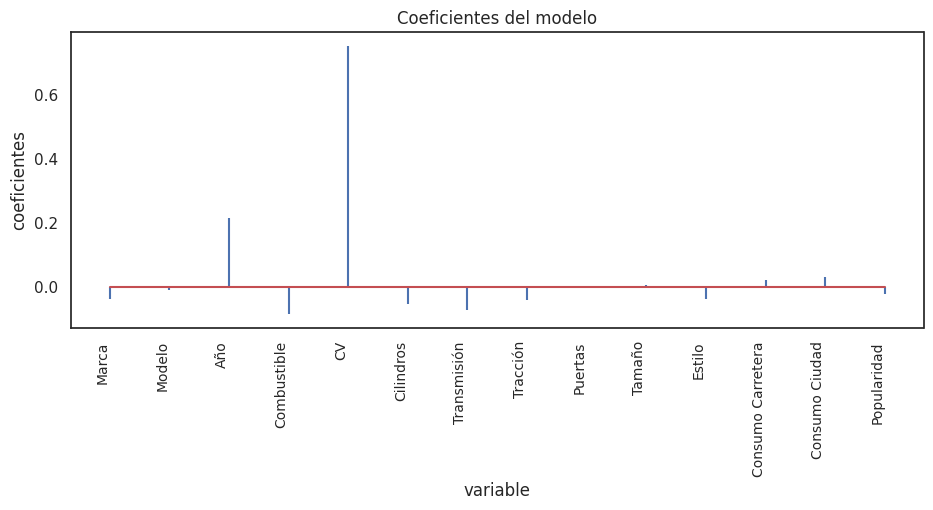

In [119]:
# Cogemos todas las variables explicativas
X = df2.drop(columns='Precio')
y = df2['Precio']

# Normalizamos las variables para interpretar mejor el resultado
scaler = MinMaxScaler()
scaled_features = scaler.fit_transform(X.values)
X = pd.DataFrame(scaled_features, index=X.index, columns=X.columns)
y = scaler.fit_transform(df2[['Precio']])


X_train, X_test, y_train, y_test = train_test_split(
                                        X,
                                        y,
                                        train_size   = 0.7,
                                        random_state = 1234,
                                        shuffle      = True
                                    )

# Creación y entrenamiento del modelo
modelo = linear_model.LinearRegression()
modelo.fit(X = X_train, y = y_train)

# Coeficientes del modelo
df_coeficientes = pd.DataFrame(
                        {'predictor': X_train.columns,
                         'coef': modelo.coef_.flatten()}
                  )

fig, ax = plt.subplots(figsize=(11, 3.84))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, markerfmt=' ')
plt.xticks(rotation=90, ha='right', size=10)
ax.set_xlabel('variable')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo');

Como se puede observar la variable **Año** también está bastante correlada en comparación con las otras.Podríamos despreciar la contribución del resto de variables y eliminarlas. No obstante, vamos a ver si es suficiente para mejorar el anterior modelo:


Error cuadrático medio (MSE): 0.0121
Raíz del Error cuadrático medio (MSE): 0.1098
Coeficiente de determinación (R2): 0.7193


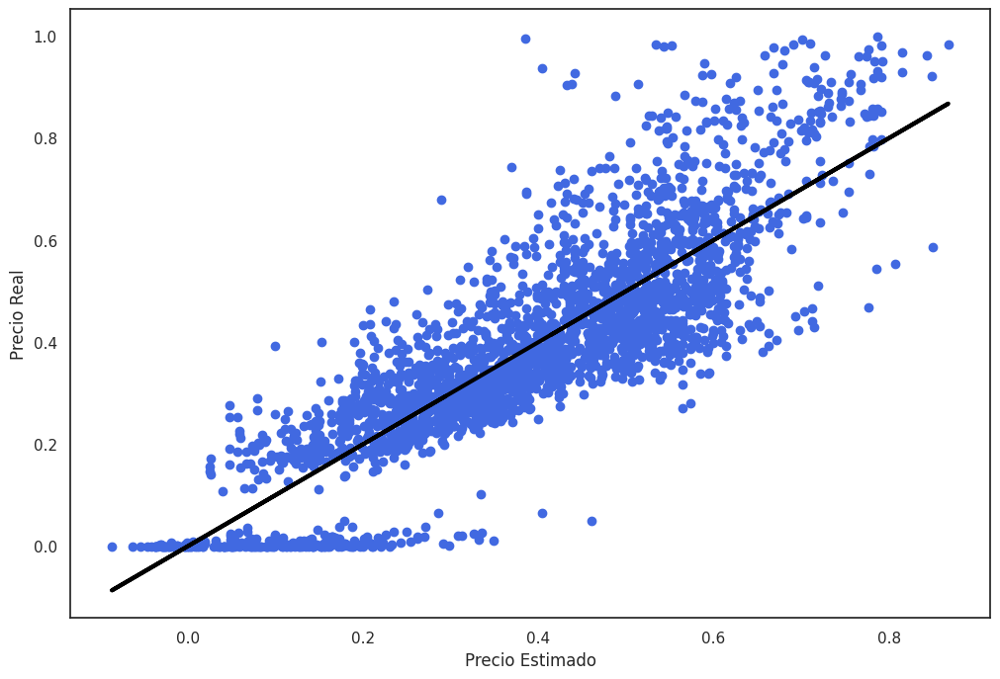

In [120]:
# Evaluamos el modelo
y_pred = modelo.predict(X=X_test)
y_pred = y_pred.flatten()
y_pred[:10]

print("")
print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Raíz del Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred,squared=False):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")

fig, ax = plt.subplots(figsize=(12,8))
plt.scatter(y_pred, y_test,  color='royalblue')
plt.plot(y_pred, y_pred, color='black', linewidth=3)

plt.xlabel('Precio Estimado')
plt.ylabel('Precio Real')
plt.show()

Ahora observamos que los resultados son mejores: con un coeficiente de determinación un poco más próximo a 1, pero sin ser del todo excelente, se se sigue considerando una buena estimación.
* Error cuadrático medio (MSE): **0.0121**
* Raíz del Error cuadrático medio (MSE): **0.1098**
* Coeficiente de determinación (R2): **0.7193**

In [121]:
# Aplanar si es necesario
if len(y_test.shape) > 1:
    y_test = y_test.ravel()
if len(y_pred.shape) > 1:
    y_pred = y_pred.ravel()

# Mostramos los valores en un dataframe
pred_df=pd.DataFrame({'Actual Value':y_test,'Predicted Value':y_pred,'Difference':y_test-y_pred})
pred_df

,Actual Value,Predicted Value,Difference
0,0.33,0.41,-0.08
1,0.43,0.53,-0.10
2,0.23,0.27,-0.04
3,0.44,0.55,-0.11
4,0.34,0.60,-0.25
...,...,...,...
2576,0.25,0.28,-0.04
2577,0.37,0.31,0.06
2578,0.72,0.44,0.28
2579,0.19,0.23,-0.04


A continuación, vamos a utilizar las regularizaciones **Ridge** y **Lasso** para ver si se comporta mejor:

### 5.3 Regularización Ridge

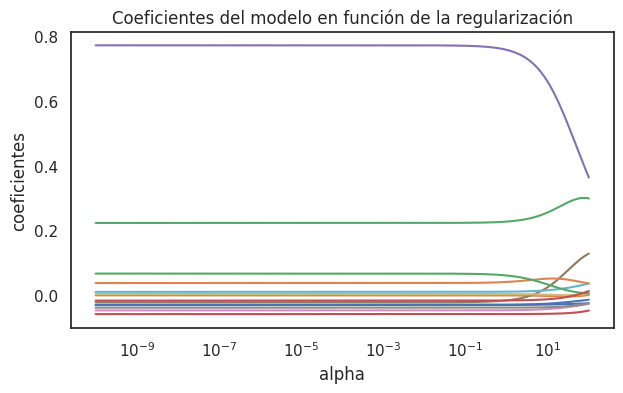

In [122]:
# Creación y entrenamiento del modelo (con búsqueda por CV del valor óptimo alpha)
# Por defecto RidgeCV utiliza el mean squared error
modelo = linear_model.RidgeCV(
            alphas          = np.logspace(-10, 2, 200),
            fit_intercept   = True,
            store_cv_values = True
         )

_ = modelo.fit(X = X_train, y = y_train)


# Evolución de los coeficientes en función de alpha
alphas = modelo.alphas
coefs = []

for alpha in alphas:
    modelo_temp = linear_model.Ridge(alpha=alpha, fit_intercept=False)
    modelo_temp.fit(X_train, y_train)
    coefs.append(modelo_temp.coef_.flatten())

fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(alphas, coefs)
ax.set_xscale('log')
ax.set_xlabel('alpha')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo en función de la regularización');
plt.axis('tight')
plt.show()

Como se puede observar **apenas tiene efecto la regularización** sobre los coeficientes de la regresión lineal, con lo que **deberíamos descartar su utilización**.

A modo ilustrativo, se incluyen los pasos a seguir en caso de que sí fuera relevante

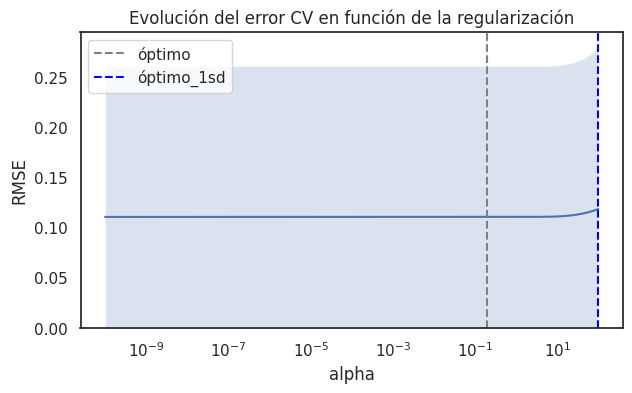

In [123]:
# Evolución del error en función de alpha

# modelo.cv_values almacena el mse de cv para cada valor de alpha. Tiene dimensiones (n_samples, n_targets, n_alphas)
mse_cv = modelo.cv_values_.reshape((-1, 200)).mean(axis=0)
mse_sd = modelo.cv_values_.reshape((-1, 200)).std(axis=0)

# Se aplica la raíz cuadrada para pasar de mse a rmse
rmse_cv = np.sqrt(mse_cv)
rmse_sd = np.sqrt(mse_sd)

# Se identifica el óptimo y el óptimo + 1std
min_rmse     = np.min(rmse_cv)
sd_min_rmse  = rmse_sd[np.argmin(rmse_cv)]
min_rsme_1sd = np.max(rmse_cv[rmse_cv <= min_rmse + sd_min_rmse])
optimo       = modelo.alphas[np.argmin(rmse_cv)]
optimo_1sd   = modelo.alphas[rmse_cv == min_rsme_1sd]


# Gráfico del error +- 1 desviación estándar
fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(modelo.alphas, rmse_cv)
ax.fill_between(
    modelo.alphas,
    rmse_cv + rmse_sd,
    rmse_cv - rmse_sd,
    alpha=0.2
)

ax.axvline(
    x         = optimo,
    c         = "gray",
    linestyle = '--',
    label     = 'óptimo'
)

ax.axvline(
    x         = optimo_1sd,
    c         = "blue",
    linestyle = '--',
    label     = 'óptimo_1sd'
)
ax.set_xscale('log')
ax.set_ylim([0,None])
ax.set_title('Evolución del error CV en función de la regularización')
ax.set_xlabel('alpha')
ax.set_ylabel('RMSE')
plt.legend();

In [124]:
# Mejor valor alpha encontrado
print(f"Mejor valor de alpha encontrado: {modelo.alpha_}")

Mejor valor de alpha encontrado: 0.19338917504552322


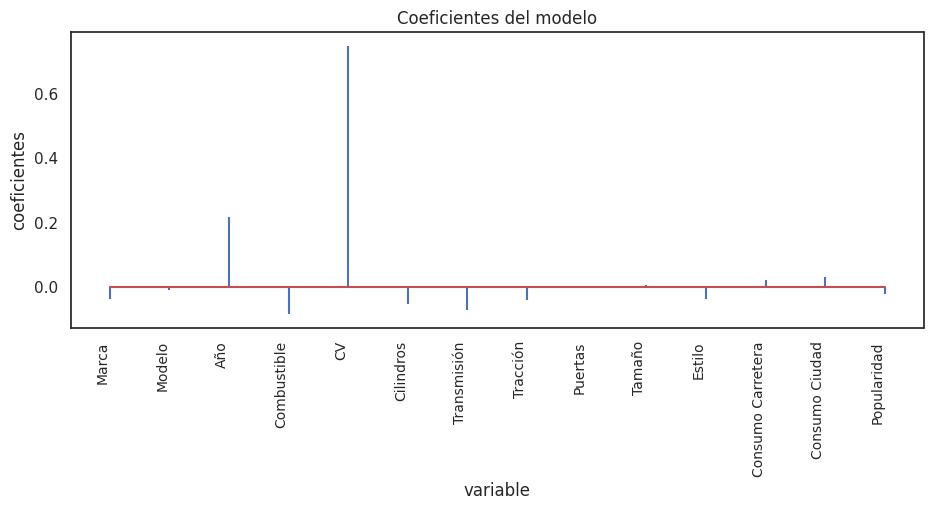

In [125]:
# Coeficientes del modelo
df_coeficientes = pd.DataFrame(
                        {'predictor': X_train.columns,
                         'coef': modelo.coef_.flatten()}
                  )

fig, ax = plt.subplots(figsize=(11, 3.84))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, markerfmt=' ')
plt.xticks(rotation=90, ha='right', size=10)
ax.set_xlabel('variable')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo');

Evaluaríamos la mejor del modelo:

In [126]:
# Predicciones test
y_pred = modelo.predict(X=X_test)
y_pred = y_pred.flatten()
y_pred[:10]

print("")
print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Raíz del Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred,squared=False):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")


Error cuadrático medio (MSE): 0.0121
Raíz del Error cuadrático medio (MSE): 0.1098
Coeficiente de determinación (R2): 0.7192


In [127]:
# Aplanar si es necesario
if len(y_test.shape) > 1:
    y_test = y_test.ravel()
if len(y_pred.shape) > 1:
    y_pred = y_pred.ravel()

# Mostramos los valores en un dataframe
pred_df=pd.DataFrame({'Actual Value':y_test,'Predicted Value':y_pred,'Difference':y_test-y_pred})
pred_df

,Actual Value,Predicted Value,Difference
0,0.33,0.41,-0.08
1,0.43,0.53,-0.10
2,0.23,0.27,-0.04
3,0.44,0.55,-0.11
4,0.34,0.59,-0.25
...,...,...,...
2576,0.25,0.28,-0.04
2577,0.37,0.31,0.06
2578,0.72,0.44,0.28
2579,0.19,0.23,-0.04


### 5.4 Regularización Lasso

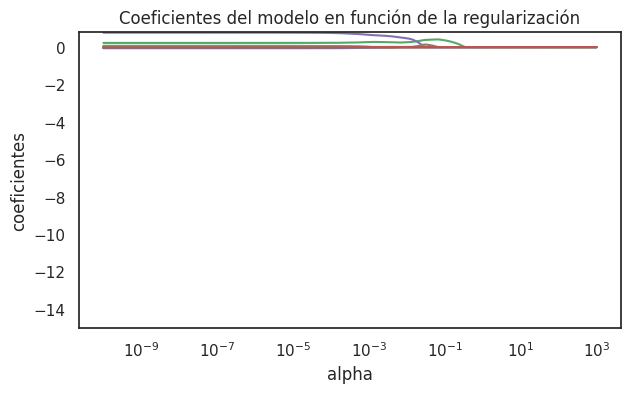

In [128]:
# Creación y entrenamiento del modelo (con búsqueda por CV del valor óptimo alpha)
# Por defecto LassoCV utiliza el mean squared error
modelo = linear_model.LassoCV(
            alphas          = np.logspace(-10, 3, 200),
            cv              = 10
         )
_ = modelo.fit(X = X_train, y = y_train)

# Evolución de los coeficientes en función de alpha
alphas = modelo.alphas_
coefs = []

for alpha in alphas:
    modelo_temp = linear_model.Lasso(alpha=alpha, fit_intercept=False)
    modelo_temp.fit(X_train, y_train)
    coefs.append(modelo_temp.coef_.flatten())

fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(alphas, coefs)
ax.set_xscale('log')
ax.set_ylim([-15,None])
ax.set_xlabel('alpha')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo en función de la regularización');

Como cabía esperar, no vamos a conseguir ningún tipo de mejora y la descartaríamos. De manera análoga a la anterior, vamos a exponer los pasos que se deberían seguir para ejecutarla ya que va a ilustrarnos como deberíamos a ver reducido la dimensionalidad del *dataset*.

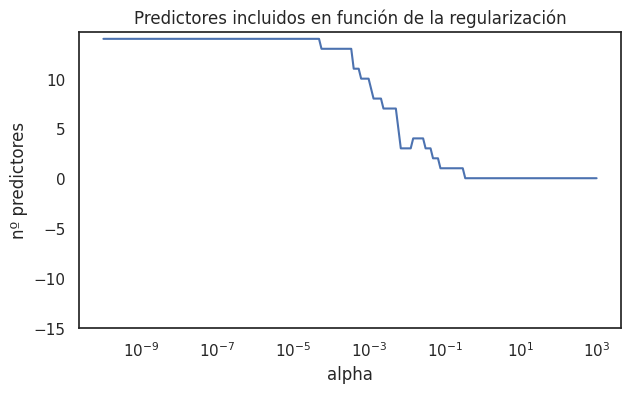

In [129]:
# Número de predictores incluidos (coeficiente !=0) en función de alpha
alphas = modelo.alphas_
n_predictores = []

for alpha in alphas:
    modelo_temp = linear_model.Lasso(alpha=alpha, fit_intercept=False)
    modelo_temp.fit(X_train, y_train)
    coef_no_cero = np.sum(modelo_temp.coef_.flatten() != 0)
    n_predictores.append(coef_no_cero)

fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(alphas, n_predictores)
ax.set_xscale('log')
ax.set_ylim([-15,None])
ax.set_xlabel('alpha')
ax.set_ylabel('nº predictores')
ax.set_title('Predictores incluidos en función de la regularización');

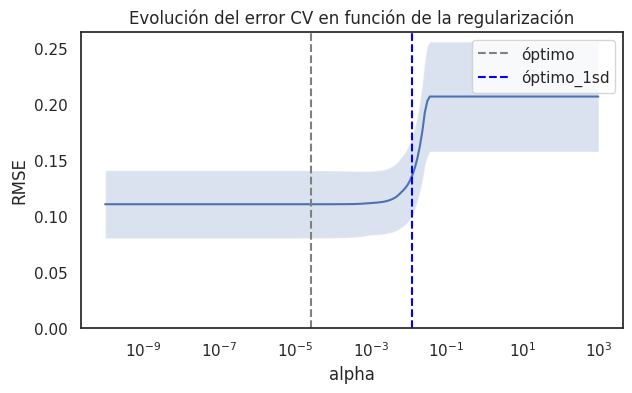

In [130]:
# Evolución del error en función de alpha
# modelo.mse_path_ almacena el mse de cv para cada valor de alpha. Tiene
# dimensiones (n_alphas, n_folds)
mse_cv = modelo.mse_path_.mean(axis=1)
mse_sd = modelo.mse_path_.std(axis=1)

# Se aplica la raíz cuadrada para pasar de mse a rmse
rmse_cv = np.sqrt(mse_cv)
rmse_sd = np.sqrt(mse_sd)

# Se identifica el óptimo y el óptimo + 1std
min_rmse     = np.min(rmse_cv)
sd_min_rmse  = rmse_sd[np.argmin(rmse_cv)]
min_rsme_1sd = np.max(rmse_cv[rmse_cv <= min_rmse + sd_min_rmse])
optimo       = modelo.alphas_[np.argmin(rmse_cv)]
optimo_1sd   = modelo.alphas_[rmse_cv == min_rsme_1sd]

# Gráfico del error +- 1 desviación estándar
fig, ax = plt.subplots(figsize=(7, 3.84))
ax.plot(modelo.alphas_, rmse_cv)
ax.fill_between(
    modelo.alphas_,
    rmse_cv + rmse_sd,
    rmse_cv - rmse_sd,
    alpha=0.2
)

ax.axvline(
    x         = optimo,
    c         = "gray",
    linestyle = '--',
    label     = 'óptimo'
)

ax.axvline(
    x         = optimo_1sd,
    c         = "blue",
    linestyle = '--',
    label     = 'óptimo_1sd'
)

ax.set_xscale('log')
ax.set_ylim([0,None])
ax.set_title('Evolución del error CV en función de la regularización')
ax.set_xlabel('alpha')
ax.set_ylabel('RMSE')
plt.legend();

In [131]:
# Mejor valor alpha encontrado
print(f"Mejor valor de alpha encontrado: {modelo.alpha_}")

Mejor valor de alpha encontrado: 2.6430814869741083e-05


In [132]:
# Mejor valor alpha encontrado + 1sd
min_rmse     = np.min(rmse_cv)
sd_min_rmse  = rmse_sd[np.argmin(rmse_cv)]
min_rsme_1sd = np.max(rmse_cv[rmse_cv <= min_rmse + sd_min_rmse])
optimo       = modelo.alphas_[np.argmin(rmse_cv)]
optimo_1sd   = modelo.alphas_[rmse_cv == min_rsme_1sd]

print(f"Mejor valor de alpha encontrado + 1 desviación estándar: {optimo_1sd}")

Mejor valor de alpha encontrado + 1 desviación estándar: [0.01260383]


In [133]:
# Mejor modelo alpha óptimo + 1sd
modelo = linear_model.Lasso(alpha=optimo_1sd[0])
modelo.fit(X_train, y_train)

Lasso(alpha=0.012603829296797275)

In [134]:
# Coeficientes del modelo
df_coeficientes = pd.DataFrame(
                        {'predictor': X_train.columns,
                         'coef': modelo.coef_.flatten()}
                  )

# Predictores incluidos en el modelo (coeficiente != 0)
df_coeficientes[df_coeficientes.coef != 0]

,predictor,coef
2,Año,0.19
4,CV,0.37
9,Tamaño,0.00


El resultado es el esperado: sólo se incluyen las dos variables que más correlación tenía.

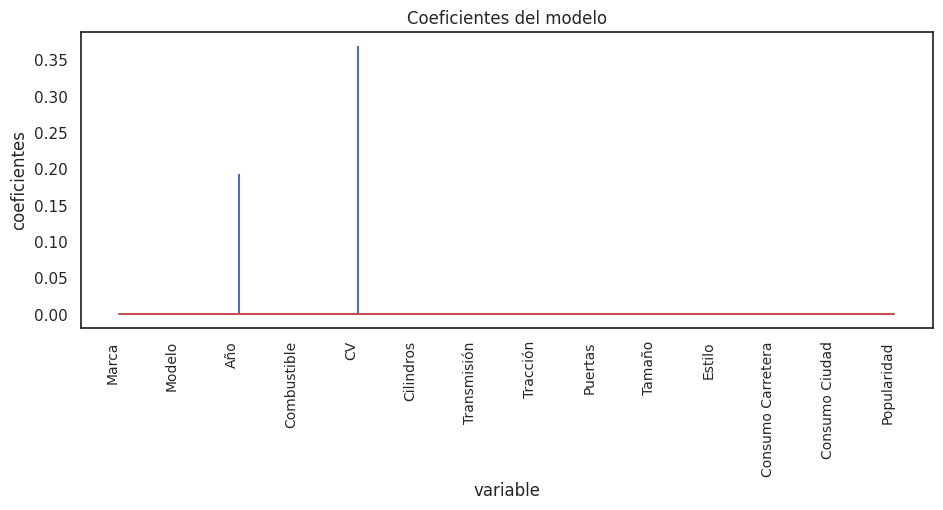

In [135]:
fig, ax = plt.subplots(figsize=(11, 3.84))
ax.stem(df_coeficientes.predictor, df_coeficientes.coef, markerfmt=' ')
plt.xticks(rotation=90, ha='right', size=10)
ax.set_xlabel('variable')
ax.set_ylabel('coeficientes')
ax.set_title('Coeficientes del modelo');

In [136]:
# Predicciones test
y_test = modelo.predict(X=X_test)
y_test = y_test.flatten()
y_test[:10]

# Error de test del modelo
rmse_lasso = mean_squared_error(
                y_true  = y_test,
                y_pred  = y_pred,
                squared = False
             )
print("")
print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Raíz del Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred,squared=False):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")


Error cuadrático medio (MSE): 0.0065
Raíz del Error cuadrático medio (MSE): 0.0804
Coeficiente de determinación (R2): 0.3561


Hemos conseguido mejorar un poco el MSE, vamos a visualizar para ver este efecto:

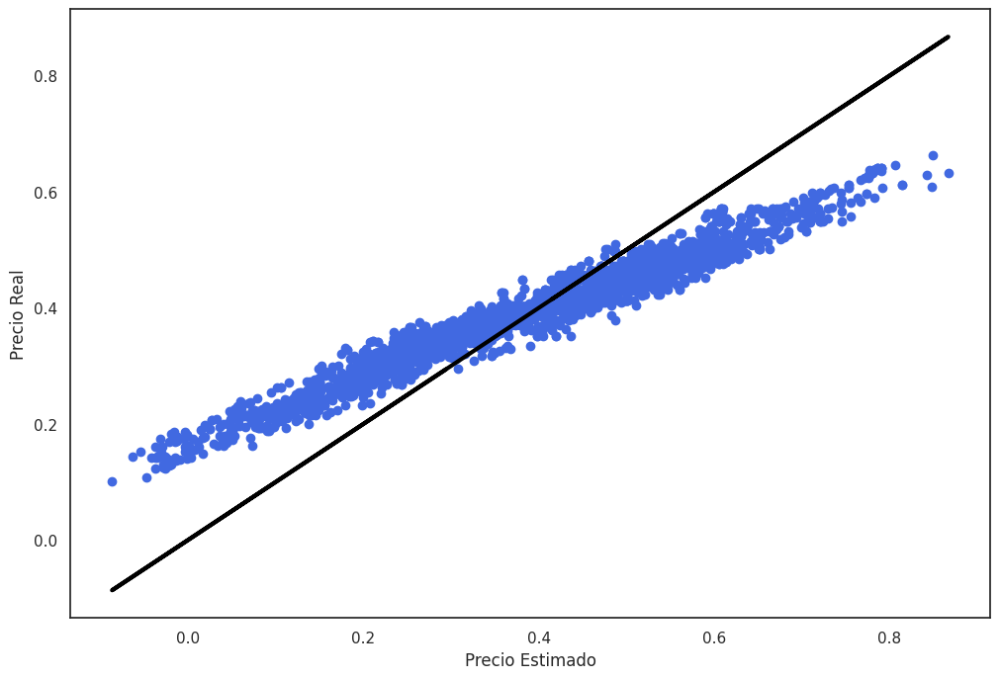

In [137]:

fig, ax = plt.subplots(figsize=(12,8))
plt.scatter(y_pred, y_test,  color='royalblue')
plt.plot(y_pred, y_pred, color='black', linewidth=3)

plt.xlabel('Precio Estimado')
plt.ylabel('Precio Real')
plt.show()

Como se puede observar, el efecto de la regularización Lasso, nos ha "concentrado" los puntos, minimizando el MSE, pero bajando mucho el coeficiente de determinación.

In [138]:
# Aplanar si es necesario
if len(y_test.shape) > 1:
    y_test = y_test.ravel()
if len(y_pred.shape) > 1:
    y_pred = y_pred.ravel()

# Mostramos los valores en un dataframe
pred_df=pd.DataFrame({'Actual Value':y_test,'Predicted Value':y_pred,'Difference':y_test-y_pred})
pred_df

,Actual Value,Predicted Value,Difference
0,0.42,0.41,0.00
1,0.48,0.53,-0.04
2,0.34,0.27,0.07
3,0.48,0.55,-0.07
4,0.53,0.59,-0.06
...,...,...,...
2576,0.33,0.28,0.05
2577,0.35,0.31,0.04
2578,0.43,0.44,-0.01
2579,0.34,0.23,0.11


In [139]:
df_pred=pd.DataFrame({'Actual Value':y_test,'Predicted Value':y_pred,'Difference':y_test-y_pred})
pred_df

,Actual Value,Predicted Value,Difference
0,0.42,0.41,0.00
1,0.48,0.53,-0.04
2,0.34,0.27,0.07
3,0.48,0.55,-0.07
4,0.53,0.59,-0.06
...,...,...,...
2576,0.33,0.28,0.05
2577,0.35,0.31,0.04
2578,0.43,0.44,-0.01
2579,0.34,0.23,0.11


### 5.5 Random Forest

Se buscará mediante el modelo de Regresión de Random Forest mejorar la precisión del modelo.

In [140]:
# Generamos el dataset de entrenamiento y el de test
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.30, random_state=42)

# Definición del modelo
rf_reg = RandomForestRegressor()

# Entrenamineto
rf_reg.fit(X_train, y_train)

# Predicción
y_pred= rf_reg.predict(X_test)
print(f"Precisión en Traing set: {rf_reg.score(X_train,y_train):.4f}")
print(f"Presición en Testing set: {rf_reg.score(X_test,y_test):.4f}")

Precisión en Traing set: 0.9806
Presición en Testing set: 0.9379


Podemos observar claramente como mejora nuestro modelo con el Modelo de Regresión Random Forest, obteniendo una Presición en Testing set muy proxima a 1

* Precisión Testing set:  0.938701065411471

In [141]:
# Aplanar si es necesario
if len(y_test.shape) > 1:
    y_test = y_test.ravel()
if len(y_pred.shape) > 1:
    y_pred = y_pred.ravel()

# Mostramos los valores en un dataframe
pred_df=pd.DataFrame({'Actual Value':y_test,'Predicted Value':y_pred,'Difference':y_test-y_pred})
pred_df

,Actual Value,Predicted Value,Difference
0,0.39,0.41,-0.02
1,0.34,0.32,0.02
2,0.73,0.65,0.08
3,0.55,0.58,-0.03
4,0.70,0.82,-0.12
...,...,...,...
2576,0.00,0.00,0.00
2577,0.43,0.45,-0.02
2578,0.45,0.43,0.02
2579,0.29,0.34,-0.05


Error cuadrático medio (MSE): 0.0026
Raiz del error cuadrático medio: 0.0512
Coeficiente de determinación (R2): 0.9379


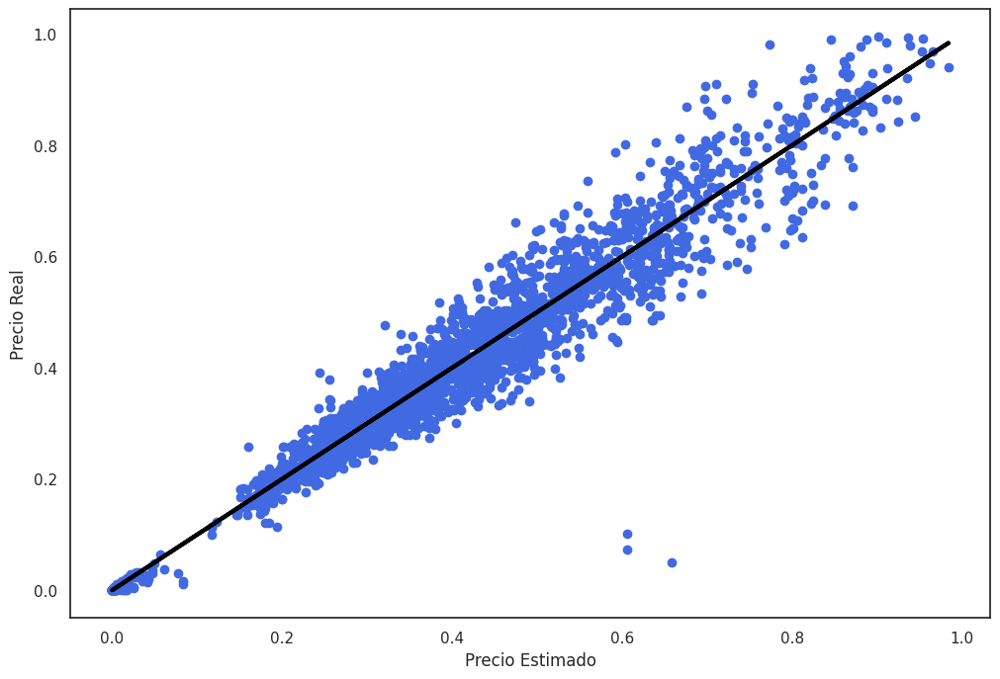

In [142]:
fig, ax = plt.subplots(figsize=(12,8))
plt.scatter(y_pred, y_test,  color='royalblue')
plt.plot(y_pred, y_pred, color='black', linewidth=3)

print(f"Error cuadrático medio (MSE): {mean_squared_error(y_test, y_pred):.4f}")
print(f"Raiz del error cuadrático medio: {np.sqrt(mean_squared_error(y_test, y_pred)):.4f}")
print(f"Coeficiente de determinación (R2): {r2_score(y_test, y_pred):.4f}")

plt.xlabel('Precio Estimado')
plt.ylabel('Precio Real')
plt.show()

## Despliegue

Se realiza un narrativa de datos sencilla que se adjuntará junto con el presente Notebook.

* M7_Historia_Precios_Coches_Usados

Además se adjuntará un cuadro de mandos realizado con el conjunto de datos obtenido luego de la Preparación de los datos. Este cuadro de mandos facilita un poco la observación del comportamiento de las variables.

* M7_Dashboard_Precios_Coches_Usados